<a href="https://colab.research.google.com/github/NecoPottsun/Germinated-Palm-Oil-Seeds-Classification-using-MEAR/blob/main/germinatedpalmoilseedsclassification_final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**About**

Germinated Palm Oil Seeds classification is my final year project. It is a private dataset with 3 different batches.
- Batch 1, which is used for training and validating,
  - Training set: 701 good seeds and 651 bad seeds.
  - Validation set: 200 good/bad seeds.

- Batch 2 and batch 3 with different lighting conditions
  - Batch 2: 450 good/bad seeds
  - Batch 3: 305 good seeds and 693 bad seeds.

Identified overfitting problems occured when using pre-trained models to train in batch 1 and test in batch 2 and 3, I seek to solve the overfitting by enhancing the resilience and robustness of the models by using Multiexpert Adversarial Reguralization training.

The trained MEAR models (MEAR Wide ResNet, and MEAR ResNeXt) can be downloaded through this link: https://drive.google.com/drive/folders/1Up6C_p_Gc3zrzjWfeko_QLv1i9e70rLs?usp=sharing



# Read datasets

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
import numpy as np
import os

In [ ]:
# Device configuration
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [ ]:
import torch
from torch.utils.data import Dataset
from torchvision import datasets
from torchvision.transforms import ToTensor, RandomHorizontalFlip, RandomVerticalFlip, Normalize
from torch.utils.data import DataLoader, RandomSampler, ConcatDataset
# from pylab import *

In [ ]:
IMAGESIZE = 256
BATCH_SIZE = 64

In [ ]:
train_transforms = transforms.Compose([
    transforms.Resize((IMAGESIZE,IMAGESIZE)),
    transforms.RandomHorizontalFlip(0.5),
    transforms.RandomVerticalFlip(0.5),
    transforms.ToTensor(),
    transforms.Normalize((0.1307,), (0.3081,))
])
test_transforms = transforms.Compose([
    transforms.Resize((IMAGESIZE,IMAGESIZE)),
    transforms.ToTensor(),
    transforms.Normalize((0.1307,), (0.3081,))
])

## Read data from drive
Running from drive, the path of the dataset is set up as follow: "/content/drive/MyDrive/AAR/dataset-20231122T102358Z-001/dataset/"

In [ ]:
# Mount Drive
from google.colab import auth, drive
auth.authenticate_user()
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
train_dataset = datasets.ImageFolder('/content/drive/MyDrive/AAR/dataset-20231122T102358Z-001/dataset/train', transform = train_transforms)
test_dataset = datasets.ImageFolder('/content/drive/MyDrive/AAR/dataset-20231122T102358Z-001/dataset/test', transform = test_transforms)
validation_dataset = datasets.ImageFolder('/content/drive/MyDrive/AAR/dataset-20231122T102358Z-001/dataset/validation', transform = test_transforms)

## Read data from local machine's directory

The Germinated Oil Palm Seeds should be placed inside the COMP3024_Software_TrangThanhMaiDuyen_20401942 folder to use this path


Step to run jupyter: go cmd, type the command: jupyter notebook --notebook-dir={path_where_the_folder_is_placed}/COMP3024_Software_TrangThanhMaiDuyen_20401942


In [ ]:
train_dataset = datasets.ImageFolder('../COMP3024_Software_TrangThanhMaiDuyen_20401942/GerminatedOilPalmSeeds/dataset-20231122T102358Z-001/dataset/train', transform = train_transforms)
test_dataset = datasets.ImageFolder('../COMP3024_Software_TrangThanhMaiDuyen_20401942/GerminatedOilPalmSeeds/dataset-20231122T102358Z-001/dataset/test', transform = test_transforms)
validation_dataset = datasets.ImageFolder('../COMP3024_Software_TrangThanhMaiDuyen_20401942/GerminatedOilPalmSeeds/dataset-20231122T102358Z-001/dataset/validation', transform = test_transforms)

# Data preparation

In [ ]:
print(len(train_dataset))
print(len(test_dataset))
print(len(validation_dataset))

1752
401
400


In [ ]:
# use_cuda= False
# # Using DataLoader Class with the GPU
# kwargs = {'num_workers': 1, 'pin_memory': True} if use_cuda else {}
train_loader = DataLoader(
    train_dataset,
    batch_size = BATCH_SIZE,
    sampler = RandomSampler(train_dataset),
    num_workers = 0,
)
val_loader = DataLoader(
    validation_dataset,
    batch_size = BATCH_SIZE,
    num_workers = 0,
)

In [ ]:
print(train_dataset.classes)

['BadSeed', 'GoodSeed']


In [ ]:
labels_map = train_dataset.classes

## Batch 1
For models training and validating

### Weak Augmented Data

In [ ]:
# Weak Augmentation
weak_train_loader = train_loader

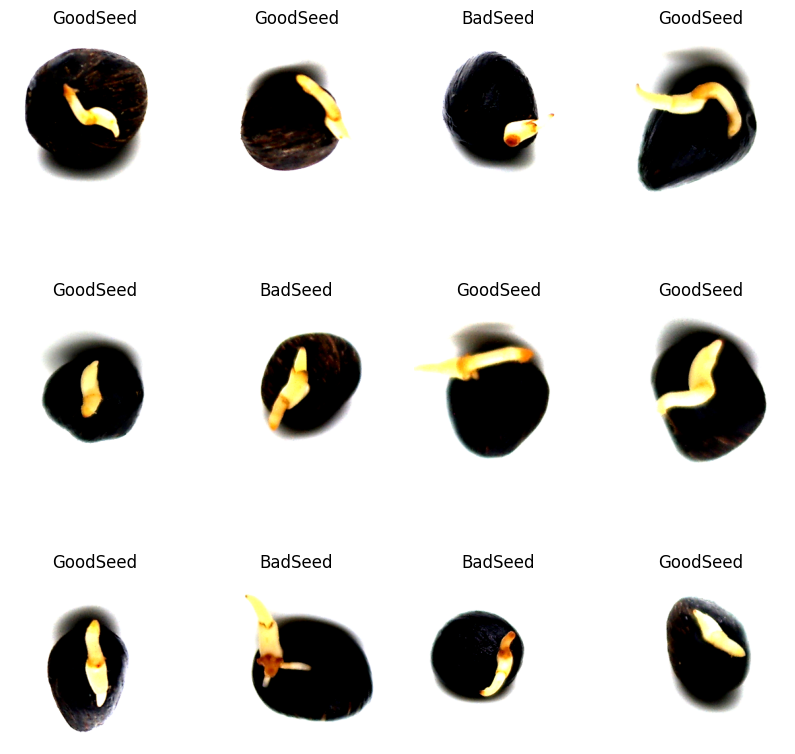

In [ ]:
# print weak train dataset
# Display the dataset after preparation and preprocessing
weak_train_loader_iter = iter(weak_train_loader)
images, labels = next(weak_train_loader_iter)
# plt.imshow(images[2].permute(1,2,0))
# plt.imshow(images[2].permute(1,2,0), norm= None)
plt.figure(figsize = (10,10))
for i in range(12):
    ax = plt.subplot(3,4,i+1)
    plt.imshow(images[i].permute(1,2,0), norm= None)
    plt.title(labels_map[labels[i]])
    plt.axis("off")


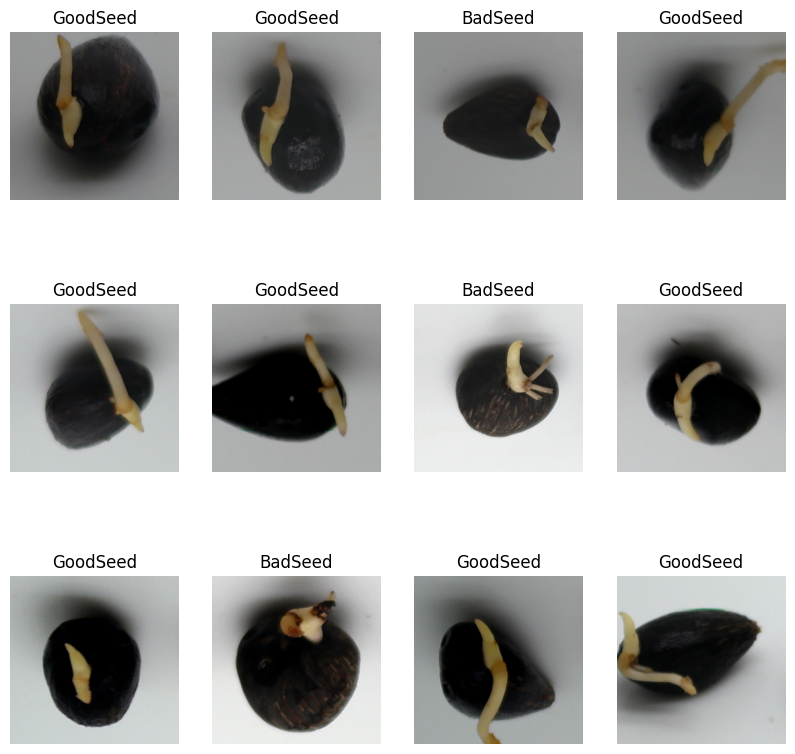

In [ ]:
# Without Normalization
images, labels = next(weak_train_loader_iter)
# plt.imshow(images[2].permute(1,2,0))
# plt.imshow(images[2].permute(1,2,0), norm= None)
plt.figure(figsize = (10,10))
for i in range(12):
    ax = plt.subplot(3,4,i+1)
    plt.imshow(images[i].permute(1,2,0), norm= None)
    plt.title(labels_map[labels[i]])
    plt.axis("off")


### Strong Augmented Data

In [ ]:
# Strong Augmentation
strong_train_transforms = transforms.Compose([
    transforms.RandAugment(num_ops = 2),
    transforms.Resize((IMAGESIZE,IMAGESIZE)),
    transforms.ToTensor(),
    transforms.Normalize((0.1307,), (0.3081,)),
])
print(strong_train_transforms)

Compose(
    RandAugment(num_ops=2, magnitude=9, num_magnitude_bins=31, interpolation=InterpolationMode.NEAREST, fill=None)
    Resize(size=(256, 256), interpolation=bilinear, max_size=None, antialias=True)
    ToTensor()
    Normalize(mean=(0.1307,), std=(0.3081,))
)


In [ ]:
# strong_train_dataset = datasets.ImageFolder('/content/drive/MyDrive/AAR/dataset-20231122T102358Z-001/dataset/train', transform = strong_train_transforms)
strong_train_dataset = datasets.ImageFolder('../COMP3024_Software_TrangThanhMaiDuyen_20401942/GerminatedOilPalmSeeds/dataset-20231122T102358Z-001/dataset/train', transform = strong_train_transforms)
strong_train_loader = DataLoader(
    strong_train_dataset,
    batch_size = BATCH_SIZE,
    sampler = RandomSampler(strong_train_dataset),
    num_workers = 0,
)

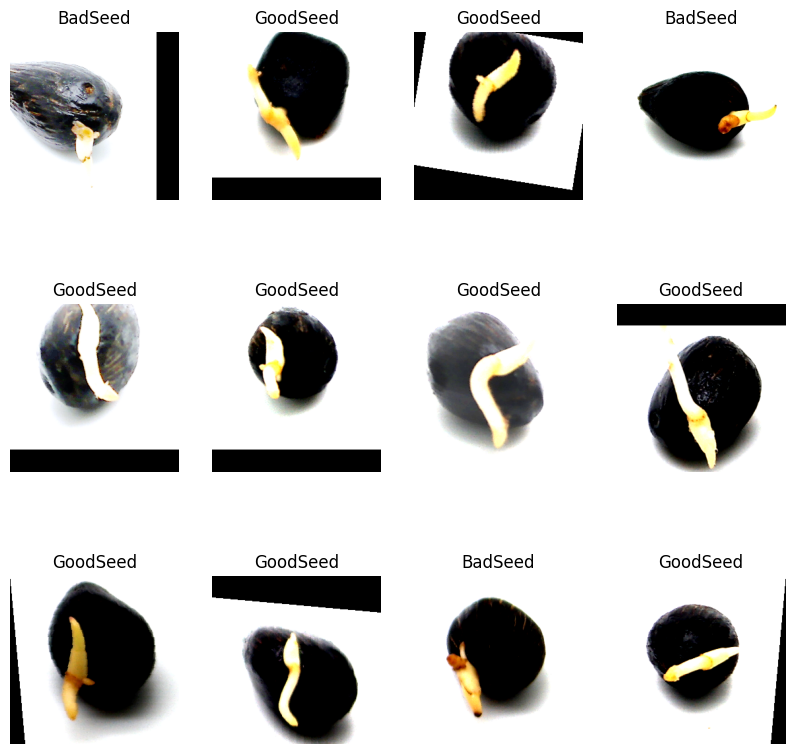

In [ ]:
# print strong train dataset
# Display the dataset after preparation and preprocessing
strong_train_loader_iter = iter(strong_train_loader)
images, labels = next(strong_train_loader_iter)
# plt.imshow(images[2].permute(1,2,0))
# plt.imshow(images[2].permute(1,2,0), norm= None)
plt.figure(figsize = (10,10))
for i in range(12):
    ax = plt.subplot(3,4,i+1)
    plt.imshow(images[i].permute(1,2,0), norm= None)
    plt.title(labels_map[labels[i]])
    plt.axis("off")

## Batch 2
For models validating

In [ ]:
# test2_dataset = datasets.ImageFolder('/content/drive/MyDrive/AAR/dataset-20231122T102358Z-001/dataset/NormalRoomLighting/All', transform = test_transforms)
test2_dataset = datasets.ImageFolder('../COMP3024_Software_TrangThanhMaiDuyen_20401942/GerminatedOilPalmSeeds/dataset-20231122T102358Z-001/dataset/NormalRoomLighting/All', transform = test_transforms)
test2_loader = DataLoader(
    test2_dataset,
    batch_size = BATCH_SIZE,
    num_workers = 0,
)

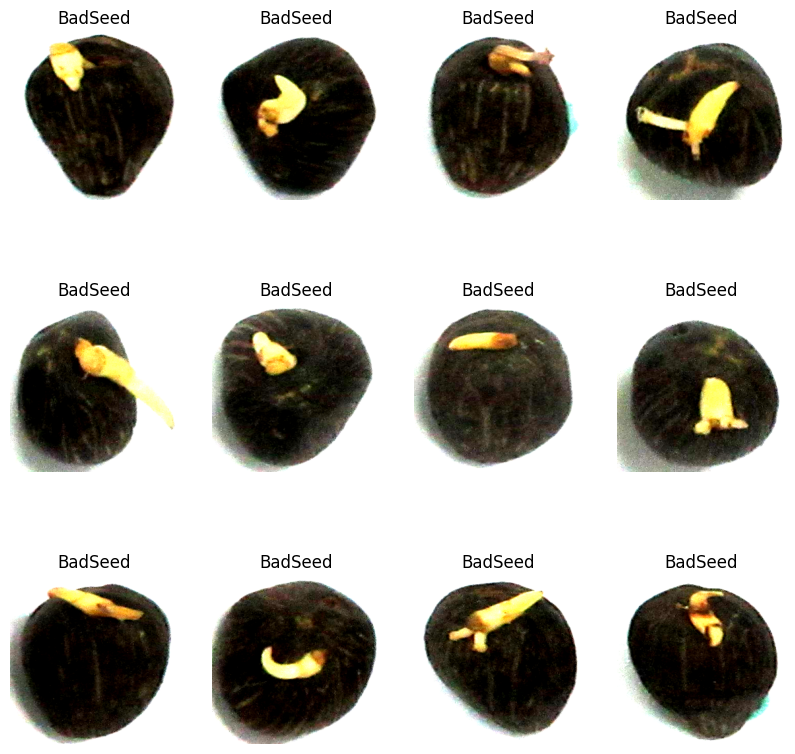

In [ ]:
# print Batch 2 dataset
# Display the dataset after preparation and preprocessing
test2_iter = iter(test2_loader)
images, labels = next(test2_iter)
# plt.imshow(images[2].permute(1,2,0))
# plt.imshow(images[2].permute(1,2,0), norm= None)
plt.figure(figsize = (10,10))
for i in range(12):
    ax = plt.subplot(3,4,i+1)
    plt.imshow(images[i].permute(1,2,0), norm= None)
    plt.title(labels_map[labels[i]])
    plt.axis("off")


## Batch 3
For models validating

In [ ]:
# test3_dataset = datasets.ImageFolder('/content/drive/MyDrive/AAR/dataset-20231122T102358Z-001/dataset/LightBox/All', transform = test_transforms)
test3_dataset = datasets.ImageFolder('../COMP3024_Software_TrangThanhMaiDuyen_20401942/GerminatedOilPalmSeeds/dataset-20231122T102358Z-001/dataset/LightBox/All', transform = test_transforms)
test3_loader = DataLoader(
    test3_dataset,
    batch_size = BATCH_SIZE,
    num_workers = 0,
)

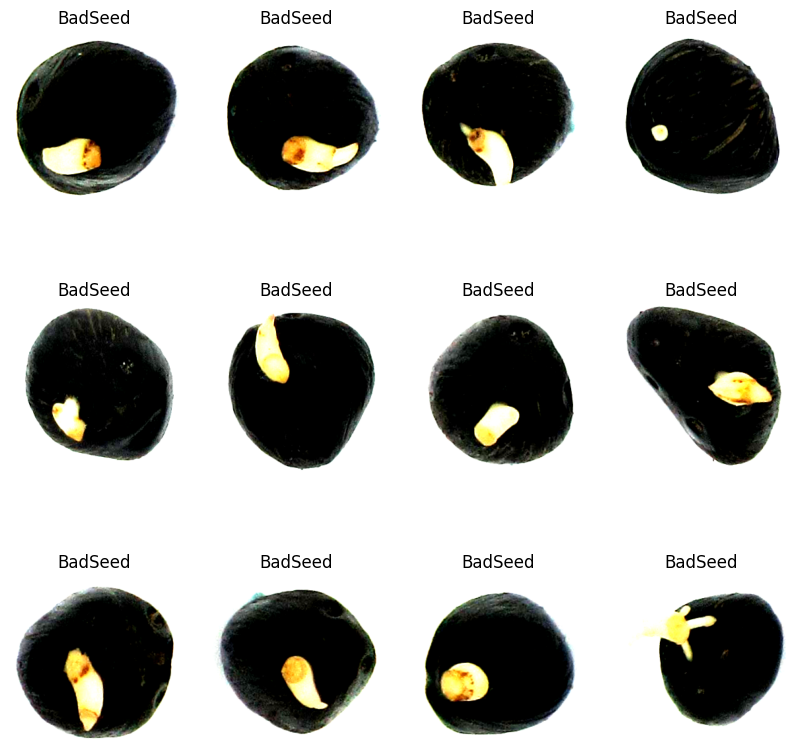

In [ ]:
# print Batch 3 dataset
# Display the dataset after preparation and preprocessing
test3_iter = iter(test3_loader)
images, labels = next(test3_iter)
# plt.imshow(images[2].permute(1,2,0))
# plt.imshow(images[2].permute(1,2,0), norm= None)
plt.figure(figsize = (10,10))
for i in range(12):
    ax = plt.subplot(3,4,i+1)
    plt.imshow(images[i].permute(1,2,0), norm= None)
    plt.title(labels_map[labels[i]])
    plt.axis("off")


# Training and Evaluation Functions and Classes


### Normal
Normal train and evaluate function for regular models

In [ ]:
def train(model, device, train_loader, optimizer, criterion):
    model.train()
    total_loss = 0
    # batchIndex, (input, targetLabel) = next(enumerate(train_loader))
    # print(targetLabel.view(-1,1).shape)
    # optimizer.zero_grad()
    # output = model(input)
    # print(output)
    # print(output.view(-1))
    # loss = criterion(output, targetLabel)
    # total_loss += loss.item()
    # print(loss)
    # Process all the batches
    for batchIndex, (input, target) in enumerate(train_loader):
        # Move the inputs and actual targets to a specified device
        input, target = input.to(device), target.to(device)
        # Reset the gradients of all parameters that the optimizer is tracking
        optimizer.zero_grad()
        # Train the model
        output = model(input)
        # calculate Loss - Forward Propagation
        loss = criterion(output, target)
        # Update total Loss
        total_loss += loss.item()
        # print(loss)
        # Compute gradients - Backward Propagation
        loss.backward()
        # Update the parameters
        optimizer.step()
    return total_loss/(batchIndex+1)


# train_loss = train(model, device, train_loader, optimizer, criterion)

In [ ]:
import sklearn.metrics as metrics
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
# Define model evaluation function
def evaluate(model, device, eval_loader, criterion):
    model.eval()
    # Initialization
    correct_eval, total_eval = 0, 0
    all_targets = torch.randn(0).to(device)
    all_predicted_labels = torch.randn(0).to(device)
    all_predicted_scores = torch.randn(0).to(device)
    total_loss = 0
    with torch.no_grad():
        for batch_idx, (input, target) in enumerate(eval_loader):
            # Move the inputs and actual targets to a specified device
            input, target = input.to(device), target.to(device)
            # Run the model
            output = model(input)
            # Obtain the predicted labels
            _, predicted_label = torch.max(output.data.detach(), 1)
            # Calculate the predicted score
            predicted_score = F.softmax(output.data.detach(), dim=1)[:,1]
            loss = criterion(output, target)
            total_eval += predicted_label.size(0)
            total_loss += loss.item()
            # total_loss += predicted_score.item()
            # Obtain correctly classifiy labels
            correct_eval += (predicted_label == target).sum().item()
            # predicted target vs actual target
            all_targets = torch.cat((all_targets, target))
            all_predicted_labels = torch.cat((all_predicted_labels, predicted_label))
            all_predicted_scores = torch.cat((all_predicted_scores, predicted_score))
    all_targets = all_targets.cpu()
    all_predicted_labels = all_predicted_labels.cpu()
    all_predicted_scores = all_predicted_scores.cpu()
    results = {}
    results['total_loss'] = total_loss/(batch_idx+1)
    # Performance metrics
    results['accuracy'] = accuracy_score(all_targets, all_predicted_labels)
    results['precision'] = precision_score(all_targets, all_predicted_labels, average='binary')
    results['recall'] = recall_score(all_targets, all_predicted_labels, average='binary')
    results['f1'] = f1_score(all_targets, all_predicted_labels, average='binary')
    # Confusion matrix
    fpr, tpr, threshold = metrics.roc_curve(all_targets, all_predicted_scores)
    results['fpr'] = fpr
    results['tpr'] = tpr
    results['correct'] = correct_eval
    results['total'] = total_eval
    results['targets'] = all_targets
    results['predictions'] = all_predicted_labels
    results['predicted_scores'] = all_predicted_scores

    return results

# out_put evaluate(net, device, val_loader, criterion)


### MEAR
*Run all of this section for MEAR model*

#### Expert Class
*  Each expert is constructed with a picked feature extractor and a fully connected layer.
*   All experts share the same feature extractor but different fully connected layers

In [ ]:
class Expert(nn.Module):
  def __init__(self, model):
    super(Expert, self).__init__()
    self.model = model

  def forward(self, x):
    x = self.model(x)
    if hasattr(self.model, 'additional_layer'):
      x = self.model.additional_layer(x)
    return x

  def setFixedFeatureExtractor(self):
    # Freeze Feature Extractor
    for param in self.model.parameters():
      param.requires_grad = False
    # Unfreeze Expert
    for param in self.model.fc.parameters():
      param.requires_grad = True
    if hasattr(self.model, 'additional_layer'):
      for param in self.model.additional_layer.parameters():
        param.requires_grad = True

  def setTrainableFeatureExtractor(self):
    # Freeze Expert
    for param in self.model.parameters():
      param.requires_grad = False
    for param in self.model.fc.parameters():
      param.requires_grad = False
    if hasattr(self.model, 'additional_layer'):
      for param in self.model.additional_layer.parameters():
        param.requires_grad = False
    # Unfreeze Feature extractor
    for param in self.model.layer4.parameters():
      param.requires_grad = True
    # for param in self.model.layer3.parameters():
    #   param.requires_grad = True

#### Expert Training
Freeze the feature extractor layers and train the last fully connected layers.


In [ ]:
def trainExperts(experts, device, weak_train_loader, strong_train_loader, optimizer, criterion, lamda):
  for expert in experts:
    expert.setFixedFeatureExtractor()
    expert.train()

  loss_experts = 0
  total_loss = 0
  l1 = nn.L1Loss(reduction = 'sum')
  l2 = nn.MSELoss(reduction = 'sum')

  for batchIndex, ((weak_input, weak_target), (strong_input, strong_target)) in enumerate(zip(weak_train_loader, strong_train_loader)):
    weak_input, weak_target = weak_input.to(device), weak_target.to(device)
    strong_input, strong_target = strong_input.to(device), strong_target.to(device)
    optimizer.zero_grad()

    loss_s = 0
    loss_d = 0
    strong_outputs = torch.zeros(strong_input.size(0), 2).to(device)
    for expert in experts:
      weak_output = expert(weak_input)
      strong_output = expert(strong_input)

      loss_s += criterion(torch.log(weak_output), weak_target)
      strong_outputs += strong_output

    supervised_loss = loss_s/len(experts)
    ensemble = strong_outputs/len(experts)

    for expert in experts:
      strong_output = expert(strong_input)
      loss_d += l1(strong_output, ensemble)
      # print("loss_d = ", loss_d)


    diversity_loss = -loss_d/BATCH_SIZE
    # print("supervised_loss = ", supervised_loss)
    # print("diversity_loss = " , diversity_loss)
    loss_experts = supervised_loss + lamda*diversity_loss
    total_loss += loss_experts.item()
    # print("loss_experts = ", loss_experts)
    # print("Total experts loss = ", loss_experts)
    # print("total loss = ", total_loss)

    loss_experts.backward()
    optimizer.step()

  return total_loss/(batchIndex + 1)



#### Feature Extraction Training
Freeze the last fully connected layers that are just trained, unfreeze the feature extractor parameters and train them.

In [ ]:
def trainFeatureExtration(experts, device, weak_train_loader, strong_train_loader, optimizer, criterion1, criterion2, lamda, gamma):
  for expert in experts:
    expert.setTrainableFeatureExtractor()
    expert.train()
  loss_feature_extractor = 0
  total_loss = 0
  for batchIndex, ((weak_input, weak_target), (strong_input, strong_target)) in enumerate(zip(weak_train_loader, strong_train_loader)):
    weak_input, weak_target = weak_input.to(device), weak_target.to(device)
    strong_input, strong_target = strong_input.to(device), strong_target.to(device)
    optimizer.zero_grad()

    loss_s = 0
    loss_c = 0
    strong_outputs = torch.zeros(strong_input.size(0), 2).to(device)
    for expert in experts:
      weak_output = expert(weak_input)
      strong_output = expert(strong_input)
      loss_s += criterion1(torch.log(weak_output), weak_target)
      strong_outputs += strong_output

    supervised_loss = loss_s/len(experts)
    strong_outputs = strong_outputs/len(experts)
    consensus_loss = criterion1(torch.log(strong_outputs), strong_target)
    loss_feature_extractor = supervised_loss + gamma*consensus_loss
    total_loss += loss_feature_extractor.item()
    loss_feature_extractor.backward()
    optimizer.step()
  return total_loss/(batchIndex + 1)


#### Evaluation Function

In [ ]:
from types import NotImplementedType
import sklearn.metrics as metrics
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# Define model evaluation function
def evaluate(experts, device, eval_loader, criterion):
    # model.eval()
    for expert in experts:
      expert.eval()

    # Initialization
    correct_eval, total_eval = 0, 0
    total_loss = 0
    all_targets = torch.randn(0).to(device)
    all_predicted_labels = torch.randn(0).to(device)
    all_predicted_scores = torch.randn(0).to(device)
    # all_expert_targets = torch.randn(0).to(device)
    all_expert_targets = []
    all_expert_predicted_labels = []
    all_expert_predicted_scores = []
    final_predictions = torch.randn(0).to(device)
    losses = []
    # all_targets = torch.randn(0).to(device)


    with torch.no_grad():
        for batch_idx, (input, target) in enumerate(eval_loader):
            # Move the inputs and actual targets to a specified device
            input, target = input.to(device), target.to(device)

            experts_targets = torch.tensor([]).to(device)
            experts_predicted_labels = torch.tensor([]).to(device)
            experts_predicted_scores = torch.tensor([]).to(device)
            mean_experts_predicted_scores = None
            # all_targets = torch.cat((all_targets, target))
            # print(all_targets)

            # Compute the output of all experts eval sample input
            i = 0
            loss = 0
            for expert in experts:
              output = expert(input)
              loss += criterion(torch.log(output), target)
              # _, predicted_label = torch.max(output.data.detach(), 1)
              # predicted_score = F.softmax(output.data.detach(), dim=1)[:,1]
              # expert_targets.append(target)

              # Ensemble experts output by concatinate the tensors
              experts_predicted_scores = torch.cat((experts_predicted_scores, output), dim = -1)
              if mean_experts_predicted_scores is None:
                mean_experts_predicted_scores = output
              else:
                mean_experts_predicted_scores += output
              # experts_predicted_labels = torch.cat((experts_predicted_labels,predicted_label), dim = 0)


              # print(f'Expert{i}: {batch_idx+1}.  {str(output)}\t')
              # print("Predicted labels = " , predicted_label)
              i += 1

            loss = loss/len(experts)
            # print("loss = ", loss)
            total_loss += loss.item()
            losses.append(loss.item())
            # print("expert_predicted_scores = ", experts_predicted_scores)
            _, predicted_labels = torch.max(experts_predicted_scores, 1)
            # 2 experts' outputs merge will result in tensor ([[... , .... , .... , ....],[...,...,....,....],..])
            # check max of size 4 might be result in argmax = 2, argmax = 3 <=> consider result in expert 2 which is basically 0 , 1 => index 2 = label 0, index 3 = label 1
            for i in range(len(predicted_labels)):
              if predicted_labels[i] == 2:
                predicted_labels[i] = 0
              elif predicted_labels[i] == 3:
                predicted_labels[i] = 1
            mean_experts_predicted_scores = mean_experts_predicted_scores/len(experts)
            # print("mean_experts_predicted_scores = ", mean_experts_predicted_scores)
            predicted_scores = mean_experts_predicted_scores[:,1]
            # predicted_scores = experts_predicted_scores[:, 1]
            # print("predicted_scores = ", predicted_scores)

            # print("actual y = ", target)
            # print("experts_predicted_labels = ", predicted_labels)
            total_eval += predicted_labels.size(0)

            # print("total_eval = ", total_eval)
            correct_eval += (predicted_labels == target).sum().item()
            # print("correct_eval = ", correct_eval)

            all_targets = torch.cat((all_targets, target), dim = 0)
            all_predicted_labels = torch.cat((all_predicted_labels, predicted_labels), dim = 0)
            all_predicted_scores = torch.cat((all_predicted_scores, predicted_scores), dim = 0)
            # print("all_predicted_scores = ", all_predicted_scores)
            # print("all_predicted_labels = ", all_predicted_labels)
    all_targets = all_targets.cpu()
    all_predicted_labels = all_predicted_labels.cpu()
    all_predicted_scores = all_predicted_scores.cpu()
    results = {}
    results['total_loss'] = total_loss/(batch_idx+1)
    results['losses'] = losses
    # Performance metrics
    results['accuracy'] = accuracy_score(all_targets, all_predicted_labels)
    results['precision'] = precision_score(all_targets, all_predicted_labels, average='binary')
    results['recall'] = recall_score(all_targets, all_predicted_labels, average='binary')
    results['f1'] = f1_score(all_targets, all_predicted_labels, average='binary')
    # # Confusion matrix
    fpr, tpr, threshold = metrics.roc_curve(all_targets, all_predicted_scores)
    results['fpr'] = fpr
    results['tpr'] = tpr
    results['correct'] = correct_eval
    results['total'] = total_eval
    results['targets'] = all_targets
    results['predictions'] = all_predicted_labels
    results['predicted_scores'] = all_predicted_scores

    return results

# out_put evaluate(net, device, val_loader, criterion)


### Plot graph function

In [ ]:
def plot_graph_loss(train_losses, validation_losses):
  plt.plot(train_losses, label='train loss')
  plt.plot(validation_losses, label='val loss')
  plt.xlabel('Epochs')
  plt.ylabel('Loss')
  plt.legend()
  plt.show()

# Train and Evaluate MEAR models

In [ ]:
import torch
from torchsummary import summary
from torchvision import models
import torch.optim as optim
from torch.optim.lr_scheduler import StepLR
from torch.utils.tensorboard import SummaryWriter
torch.cuda.empty_cache()

In [ ]:
!pip install tensorboard

### Parameters initialization and setup
For 1 trial



#### Experts setup

In [ ]:
# Expert 1 contains a fully connected layer and a softmax activation function
model1 = torch.hub.load('pytorch/vision:v0.10.0', 'wide_resnet50_2', pretrained=True)
if torch.cuda.is_available():
  model1.cuda()
num_features = model1.fc.in_features
model1.fc = nn.Sequential(
    # nn.Dropout(p=0.2),
    nn.Linear(num_features, out_features = 2),
    nn.Softmax(dim=1),
    # nn.Dropout(p = 0.5)
)
# Expert 2 contains two fully connected layers with relu and softmax activation function
model2 = torch.hub.load('pytorch/vision:v0.10.0', 'wide_resnet50_2', pretrained=True)
if torch.cuda.is_available():
  model2.cuda()
model2.fc = nn.Sequential(
  # nn.Dropout(p=0.2),
  nn.Linear(num_features, out_features = 256),
  nn.ReLU(),
  nn.Linear(256, out_features = 2),
  nn.Softmax(dim=1),
  # nn.Dropout(p = 0.5)
)

# Expert 3 contains a conv layer and a fully connected layer with relu and softmax
model3 = torch.hub.load('pytorch/vision:v0.10.0', 'wide_resnet50_2', pretrained=True)
if torch.cuda.is_available():
  model3.cuda()

model3.fc = nn.Sequential(
  nn.Flatten(),
  nn.Linear(2048,512),
  nn.BatchNorm1d(512),
  nn.ReLU(),
  # nn.Conv2d(in_features, 512, kernel_size=3, stride=1, padding=1),
  # nn.BatchNorm2d(512),
  # nn.ReLU()
)
model3.additional_layer = nn.Sequential(
    nn.Linear(512, out_features = 2),
    nn.Softmax(dim=1)
)
experts = [Expert(model1), Expert(model2)]
for expert in experts:
  expert.to(device)

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=Wide_ResNet50_2_Weights.IMAGENET1K_V1`. You can also use `weights=Wide_ResNet50_2_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


In [ ]:
model3.eval()

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), strid

#### Training setup

In [ ]:
criterion1 = nn.NLLLoss()
criterion2 = nn.NLLLoss(reduction= 'sum')
LR = 1e-3
SCHED_STEP_SIZE = 5
lamda = 0.1
gamma = 1
GAMMA = 0.9

##  Actual for training and evaluating


### MEAR Wide ResNet

#### Train in batch 1 & Test in batch 1
Manually

In [ ]:
import copy
import time
import torch
from torchsummary import summary
from torchvision import models
import torch.optim as optim
from torch.optim.lr_scheduler import StepLR
from torch.utils.tensorboard import SummaryWriter
torch.cuda.empty_cache()
experiment = "WideResNet"
time_of_run = time.strftime('%m-%d_%H-%M-%S', time.localtime())
experiment = experiment + '_' + time_of_run
logname = os.path.join('runs', experiment)
writer = SummaryWriter(logname)
model_save_name = experiment + '_' + time_of_run + '_classifier1.pt'
path_save_model = F"/content/drive/MyDrive/AAR/models/{model_save_name}"

num_epoch = 0
num_epoch_not_improved = 0
best_model_acc = 0
best_total_val = 0
best_correct_val = 0
best_model = copy.deepcopy(experts)
train_losses = []
train_feature_extraction_losses = []
validation_losses = []

# Initialize optimizer and scheduler
optimizer_c = optim.Adam(list(experts[0].model.parameters()) + list(experts[1].model.parameters()), lr=LR)
optimizer_f = optim.Adam(list(experts[0].model.parameters()) + list(experts[1].model.parameters()), lr=LR)
scheduler_c = StepLR(optimizer_c, step_size=SCHED_STEP_SIZE, gamma=GAMMA)
scheduler_f = StepLR(optimizer_f, step_size=SCHED_STEP_SIZE, gamma=GAMMA)

while num_epoch_not_improved < 20:
    num_epoch += 1
    #train
    print(f'Epoch number {num_epoch}')
    optimizer_c = optim.Adam(list(experts[0].model.parameters()) + list(experts[1].model.parameters()), lr=LR)
    train_loss = trainExperts(experts,device, weak_train_loader, strong_train_loader, optimizer_c, criterion1, lamda)
    train_losses.append(train_loss)
    optimizer_f = optim.Adam(list(experts[0].model.parameters()) + list(experts[1].model.parameters()), lr=LR)
    train_feature_extraction_loss =trainFeatureExtration(experts, device, weak_train_loader, strong_train_loader, optimizer_f, criterion1, criterion2, lamda, gamma)
    train_feature_extraction_losses.append(train_loss)
    print(f'Loss: {train_loss}')
    writer.add_scalar('Train Loss', train_loss, num_epoch)
    scheduler_c.step()
    scheduler_f.step()

    #evaluate
    output_val = evaluate(experts, device, test2_loader, criterion1)
    validation_losses.append(output_val['total_loss'])
    acc = output_val['accuracy']
    correct_val = output_val['correct']
    total_val = output_val['total']
    print('\t{0:.2f}% ({1}/{2})'.format(acc*100, correct_val, total_val))

    writer.add_scalar('Validation Accuracy', acc, num_epoch)
    writer.add_scalar('Validation Precision', output_val['precision'], num_epoch)
    writer.add_scalar('Validation Recall', output_val['recall'], num_epoch)
    writer.add_scalar('Validation f1 score', output_val['f1'], num_epoch)

    if acc > best_model_acc:
        best_model = copy.deepcopy(experts)
        torch.save(best_model, path_save_model)
        best_model_acc = acc
        best_total_val = total_val
        best_correct_val = correct_val
        num_epoch_not_improved = 0
    else:
        num_epoch_not_improved += 1

    print('Current best model validation:')
    print('\t{0:.2f}% ({1}/{2})'.format(best_model_acc*100, best_correct_val, best_total_val))
    print()
    writer.add_scalar('Best Model Accuracy', best_model_acc, num_epoch)


##### Run in 10 trials

In [ ]:
import copy
import time
import torch
from torchsummary import summary
from torchvision import models
import torch.optim as optim
from torch.optim.lr_scheduler import StepLR
from torch.utils.tensorboard import SummaryWriter
torch.cuda.empty_cache()

In [ ]:
criterion1 = nn.NLLLoss()
criterion2 = nn.NLLLoss(reduction= 'sum')
LR = 1e-3
SCHED_STEP_SIZE = 5
lamda = 0.1
gamma = 1
GAMMA = 0.9

In [ ]:
train_losses_trials = []
train_feature_extraction_losses_trials = []
validation_losses_trials = []
i = 0

In [ ]:
experiment = "WideResNet"
time_of_run = time.strftime('%m-%d_%H-%M-%S', time.localtime())
logname = os.path.join('runs', experiment)
writer = SummaryWriter(logname)
experiment = experiment + '_' + time_of_run
model_save_name = experiment + '_classifier_batch1_trial' + str(i+1) + '.pt'
path_save_model = F"/content/drive/MyDrive/AAR/models/{model_save_name}"
print(path_save_model)

/content/drive/MyDrive/AAR/models/WideResNet_04-12_13-05-52_classifier_batch1_trial10.pt


In [ ]:
# Experts initialization
# Expert 1 contains a fully connected layer and a softmax activation function
model1 = torch.hub.load('pytorch/vision:v0.10.0', 'wide_resnet50_2', pretrained=True)
if torch.cuda.is_available():
  model1.cuda()
num_features = model1.fc.in_features
model1.fc = nn.Sequential(
  nn.Linear(num_features, out_features = 2),
  nn.Softmax(dim=1),
)
# Expert 2 contains two fully connected layers with relu and softmax activation function
model2 = torch.hub.load('pytorch/vision:v0.10.0', 'wide_resnet50_2', pretrained=True)
if torch.cuda.is_available():
  model2.cuda()
model2.fc = nn.Sequential(
  nn.Linear(num_features, out_features = 256),
  nn.ReLU(),
  nn.Linear(256, out_features = 2),
  nn.Softmax(dim=1),
)
experts = [Expert(model1), Expert(model2)]
for expert in experts:
  expert.to(device)

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=Wide_ResNet50_2_Weights.IMAGENET1K_V1`. You can also use `weights=Wide_ResNet50_2_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


In [ ]:
# Initialization
num_epoch = 0
num_epoch_not_improved = 0
best_model_acc = 0
best_total_val = 0
best_correct_val = 0
best_model = copy.deepcopy(experts)
train_losses = []
train_feature_extraction_losses = []
validation_losses = []

# Initialize optimizer and scheduler
optimizer_c = optim.Adam(list(experts[0].model.parameters()) + list(experts[1].model.parameters()), lr=LR)
optimizer_f = optim.Adam(list(experts[0].model.parameters()) + list(experts[1].model.parameters()), lr=LR)
scheduler_c = StepLR(optimizer_c, step_size=SCHED_STEP_SIZE, gamma=GAMMA)
scheduler_f = StepLR(optimizer_f, step_size=SCHED_STEP_SIZE, gamma=GAMMA)

while num_epoch_not_improved < 20:
  num_epoch += 1
  #train
  print(f'Epoch number {num_epoch}')
  optimizer_c = optim.Adam(list(experts[0].model.parameters()) + list(experts[1].model.parameters()), lr=LR)
  train_loss = trainExperts(experts,device, weak_train_loader, strong_train_loader, optimizer_c, criterion1, lamda)
  train_losses.append(train_loss)
  optimizer_f = optim.Adam(list(experts[0].model.parameters()) + list(experts[1].model.parameters()), lr=LR)
  train_feature_extraction_loss =trainFeatureExtration(experts, device, weak_train_loader, strong_train_loader, optimizer_f, criterion1, criterion2, lamda, gamma)
  train_feature_extraction_losses.append(train_loss)
  print(f'Loss: {train_loss}')
  writer.add_scalar('Train Loss', train_loss, num_epoch)
  scheduler_c.step()
  scheduler_f.step()
  #evaluate
  output_val = evaluate(experts, device, val_loader, criterion1)
  validation_losses.append(output_val['total_loss'])
  acc = output_val['accuracy']
  correct_val = output_val['correct']
  total_val = output_val['total']
  print('\t{0:.2f}% ({1}/{2})'.format(acc*100, correct_val, total_val))
  writer.add_scalar('Validation Accuracy', acc, num_epoch)
  writer.add_scalar('Validation Precision', output_val['precision'], num_epoch)
  writer.add_scalar('Validation Recall', output_val['recall'], num_epoch)
  writer.add_scalar('Validation f1 score', output_val['f1'], num_epoch)
  if acc > best_model_acc:
      best_model = copy.deepcopy(experts)
      torch.save(best_model, path_save_model)
      best_model_acc = acc
      best_total_val = total_val
      best_correct_val = correct_val
      num_epoch_not_improved = 0
  else:
      num_epoch_not_improved += 1
  print('Current best model validation:')
  print('\t{0:.2f}% ({1}/{2})'.format(best_model_acc*100, best_correct_val, best_total_val))
  print()
  writer.add_scalar('Best Model Accuracy', best_model_acc, num_epoch)

Epoch number 1
Loss: 0.5969188990337508


/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:143: UserWarning: Detected call of `lr_scheduler.step()` before `optimizer.step()`. In PyTorch 1.1.0 and later, you should call them in the opposite order: `optimizer.step()` before `lr_scheduler.step()`.  Failure to do this will result in PyTorch skipping the first value of the learning rate schedule. See more details at https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate
  warnings.warn("Detected call of `lr_scheduler.step()` before `optimizer.step()`. "


	98.00% (392/400)
Current best model validation:
	98.00% (392/400)

Epoch number 2
Loss: 0.07464358706160315
	97.50% (390/400)
Current best model validation:
	98.00% (392/400)

Epoch number 3
Loss: 0.07155193980517131
	98.25% (393/400)
Current best model validation:
	98.25% (393/400)

Epoch number 4
Loss: 0.05510123775872801
	99.75% (399/400)
Current best model validation:
	99.75% (399/400)

Epoch number 5
Loss: 0.039423257478379777
	99.50% (398/400)
Current best model validation:
	99.75% (399/400)

Epoch number 6
Loss: 0.03240116013746176
	100.00% (400/400)
Current best model validation:
	100.00% (400/400)

Epoch number 7
Loss: 0.027011645982773707
	100.00% (400/400)
Current best model validation:
	100.00% (400/400)

Epoch number 8
Loss: 0.030747576101150895
	100.00% (400/400)
Current best model validation:
	100.00% (400/400)

Epoch number 9
Loss: 0.013145027711289003
	100.00% (400/400)
Current best model validation:
	100.00% (400/400)

Epoch number 10
Loss: 0.019261143282554776
	100.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


ValueError: Input contains NaN.

In [ ]:
# Record trials
train_losses_trials.append(train_losses)
train_feature_extraction_losses_trials.append(train_feature_extraction_losses)
validation_losses_trials.append(validation_losses)
i = i + 1

In [ ]:
for train_losses in train_losses_trials:
  print(train_losses)

[0.6367746953453336, 0.046694340117807896, 0.07381986570544541, 0.02952100381454719, 0.04548533295746893, 0.04832783554281507, 0.027051217646138475, 0.021548077979657267, 0.022023067260826274, 0.016515340872241983, 0.012939410928603528, 0.003871456348861102, 0.013958083656949125, 0.01145212767213317, 0.004271344165317714, 0.0076298525985164034]
[0.6170397720166615, 0.0674550092912146, 0.05836060954191323, 0.05963769212498197, 0.04532565229705402, 0.031811068466465385, 0.0129667501813466, 0.03554131681033011, 0.0195826695417054, 0.025567570992279798, 0.012063701857446827, 0.021520337805018892, 0.020711367490418655, 0.008002701656161142, 0.01012696771379394, 0.00801188872615707, 0.018135707222557227, 0.02351115268122937, nan]
[0.6076447857277734, 0.07589864102192223, 0.049433175407882245, 0.0376336361680712, 0.031247821703021015, 0.019123489669124995, 0.020798927888141146, 0.03799030078724692, 0.03267398602162887, 0.012616359121498786, 0.005857095338537225, 0.019893531149136834, 0.014203

In [ ]:
for train_feature_extraction_losses in train_feature_extraction_losses_trials:
  print(train_feature_extraction_losses)

[0.6367746953453336, 0.046694340117807896, 0.07381986570544541, 0.02952100381454719, 0.04548533295746893, 0.04832783554281507, 0.027051217646138475, 0.021548077979657267, 0.022023067260826274, 0.016515340872241983, 0.012939410928603528, 0.003871456348861102, 0.013958083656949125, 0.01145212767213317, 0.004271344165317714, 0.0076298525985164034]
[0.6170397720166615, 0.0674550092912146, 0.05836060954191323, 0.05963769212498197, 0.04532565229705402, 0.031811068466465385, 0.0129667501813466, 0.03554131681033011, 0.0195826695417054, 0.025567570992279798, 0.012063701857446827, 0.021520337805018892, 0.020711367490418655, 0.008002701656161142, 0.01012696771379394, 0.00801188872615707, 0.018135707222557227, 0.02351115268122937, nan]
[0.6076447857277734, 0.07589864102192223, 0.049433175407882245, 0.0376336361680712, 0.031247821703021015, 0.019123489669124995, 0.020798927888141146, 0.03799030078724692, 0.03267398602162887, 0.012616359121498786, 0.005857095338537225, 0.019893531149136834, 0.014203

In [ ]:
for validation_losses in validation_losses_trials:
  print(validation_losses)

[0.0491446021146008, 0.13819568635829324, 0.09407138968318966, 0.013985898196032005, 0.0665207751402964, 0.005183511546679905, 0.008227151219866105, 0.004073025405107599, 0.032501433926094184, 0.013288263512159964, 0.013073659718169697, 0.011297568417960844, 0.05335788927813415, 0.012706148606412171, 0.0014861471368671378]
[0.03188485944909709, 0.046751028458986967, 0.06004963424389383, 0.026754781869905337, 0.005256622397739973, 0.016877428636819656, 0.06187508182548689, 0.003066570828585619, 0.030781550782973812, 0.0031848095573617946, 0.0009116580295085441, 0.006207350100989321, 0.00997296248429588, 0.000534348175798576, 0.0008270944084480496, 0.012707444632854146, 0.004702254069603181, 0.002656801079865545]
[0.12606841645070485, 0.019662816875747273, 0.02029564042043473, 0.00885603646747768, 0.03022905537259898, 0.009998716081359557, 0.0023006248770148625, 0.0048163289544131006, 0.004143926959451554, 0.014016544415166468, 0.0011944922246454684, 0.003256202008092909, 0.0278120622575

In [ ]:
%load_ext tensorboard
%tensorboard --logdir runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 90096), started 0:19:05 ago. (Use '!kill 90096' to kill it.)

<IPython.core.display.Javascript object>

#### Train in batch 1 & Test in batch 2
Manually

In [ ]:
import copy
import time
import torch
from torchsummary import summary
from torchvision import models
import torch.optim as optim
from torch.optim.lr_scheduler import StepLR
from torch.utils.tensorboard import SummaryWriter
torch.cuda.empty_cache()
experiment = "WideResNet"
time_of_run = time.strftime('%m-%d_%H-%M-%S', time.localtime())
experiment = experiment + '_' + time_of_run
logname = os.path.join('runs', experiment)
writer = SummaryWriter(logname)
model_save_name = experiment + '_' + time_of_run + '_classifier_batch2.pt'
path_save_model = F"/content/drive/MyDrive/AAR/models/{model_save_name}"

num_epoch = 0
num_epoch_not_improved = 0
best_model_acc = 0
best_total_val = 0
best_correct_val = 0
best_model = copy.deepcopy(experts)
train_losses = []
validation_losses = []
scheduler = StepLR(optimizer_c, step_size=SCHED_STEP_SIZE, gamma=GAMMA)
optimizer_c = optim.Adam(list(experts[0].model.parameters()) + list(experts[1].model.parameters()), lr=LR)
optimizer_f = optim.Adam(list(experts[0].model.parameters()) + list(experts[1].model.parameters()), lr=LR)
scheduler_c = StepLR(optimizer_c, step_size=SCHED_STEP_SIZE, gamma=GAMMA)
scheduler_f = StepLR(optimizer_f, step_size=SCHED_STEP_SIZE, gamma=GAMMA)

while num_epoch_not_improved < 20:
    num_epoch += 1
    #train
    print(f'Epoch number {num_epoch}')


    train_loss = trainExperts(experts,device, weak_train_loader, strong_train_loader, optimizer_c, criterion1, lamda)
    train_losses.append(train_loss)
    trainFeatureExtration(experts, device, weak_train_loader, strong_train_loader, optimizer_f, criterion1, criterion2, lamda, gamma)
    print(f'Loss: {train_loss}')
    writer.add_scalar('Train Loss', train_loss, num_epoch)
    scheduler_c.step()
    scheduler_f.step()

    #evaluate
    output_val = evaluate(experts, device, test2_loader, criterion1)
    validation_losses.append(output_val['total_loss'])
    acc = output_val['accuracy']
    correct_val = output_val['correct']
    total_val = output_val['total']
    print('\t{0:.2f}% ({1}/{2})'.format(acc*100, correct_val, total_val))

    writer.add_scalar('Validation Accuracy', acc, num_epoch)
    writer.add_scalar('Validation Precision', output_val['precision'], num_epoch)
    writer.add_scalar('Validation Recall', output_val['recall'], num_epoch)
    writer.add_scalar('Validation f1 score', output_val['f1'], num_epoch)

    if acc > best_model_acc:
        best_model = copy.deepcopy(experts)
        torch.save(best_model, path_save_model)
        best_model_acc = acc
        best_total_val = total_val
        best_correct_val = correct_val
        num_epoch_not_improved = 0
    else:
        num_epoch_not_improved += 1

    print('Current best model validation:')
    print('\t{0:.2f}% ({1}/{2})'.format(best_model_acc*100, best_correct_val, best_total_val))
    print()
    writer.add_scalar('Best Model Accuracy', best_model_acc, num_epoch)


#### Train in batch 1 & Test in batch 3
Manually

In [ ]:
import copy
import time
import torch
from torchsummary import summary
from torchvision import models
import torch.optim as optim
from torch.optim.lr_scheduler import StepLR
from torch.utils.tensorboard import SummaryWriter
torch.cuda.empty_cache()
experiment = "WideResNet"
time_of_run = time.strftime('%m-%d_%H-%M-%S', time.localtime())
experiment = experiment + '_' + time_of_run
logname = os.path.join('runs', experiment)
writer = SummaryWriter(logname)
model_save_name = experiment + '_' + time_of_run + '_classifier_batch3.pt'
path_save_model = F"/content/drive/MyDrive/AAR/models/{model_save_name}"

num_epoch = 0
num_epoch_not_improved = 0
best_model_acc = 0
best_total_val = 0
best_correct_val = 0
best_model = copy.deepcopy(experts)
train_losses = []
validation_losses = []
scheduler = StepLR(optimizer_c, step_size=SCHED_STEP_SIZE, gamma=GAMMA)
optimizer_c = optim.Adam(list(experts[0].model.parameters()) + list(experts[1].model.parameters()), lr=LR)
optimizer_f = optim.Adam(list(experts[0].model.parameters()) + list(experts[1].model.parameters()), lr=LR)
scheduler_c = StepLR(optimizer_c, step_size=SCHED_STEP_SIZE, gamma=GAMMA)
scheduler_f = StepLR(optimizer_f, step_size=SCHED_STEP_SIZE, gamma=GAMMA)

while num_epoch_not_improved < 20:
    num_epoch += 1
    #train
    print(f'Epoch number {num_epoch}')

    train_loss = trainExperts(experts,device, weak_train_loader, strong_train_loader, optimizer_c, criterion1, lamda)
    train_losses.append(train_loss)
    trainFeatureExtration(experts, device, weak_train_loader, strong_train_loader, optimizer_f, criterion1, criterion2, lamda, gamma)
    print(f'Loss: {train_loss}')
    writer.add_scalar('Train Loss', train_loss, num_epoch)
    scheduler_c.step()
    scheduler_f.step()

    #evaluate
    output_val = evaluate(experts, device, test3_loader, criterion1)
    validation_losses.append(output_val['total_loss'])
    acc = output_val['accuracy']
    correct_val = output_val['correct']
    total_val = output_val['total']
    print('\t{0:.2f}% ({1}/{2})'.format(acc*100, correct_val, total_val))

    writer.add_scalar('Validation Accuracy', acc, num_epoch)
    writer.add_scalar('Validation Precision', output_val['precision'], num_epoch)
    writer.add_scalar('Validation Recall', output_val['recall'], num_epoch)
    writer.add_scalar('Validation f1 score', output_val['f1'], num_epoch)

    if acc > best_model_acc:
        best_model = copy.deepcopy(experts)
        torch.save(best_model, path_save_model)
        best_model_acc = acc
        best_total_val = total_val
        best_correct_val = correct_val
        num_epoch_not_improved = 0
    else:
        num_epoch_not_improved += 1

    print('Current best model validation:')
    print('\t{0:.2f}% ({1}/{2})'.format(best_model_acc*100, best_correct_val, best_total_val))
    print()
    writer.add_scalar('Best Model Accuracy', best_model_acc, num_epoch)


#### Run 5 trials merged 3 batches
Manually run each trial for observing purposes and computational saving (train once and obtain validate results of 3 batches at the same time)


In [ ]:
import copy
import time
import os
import torch
from torchsummary import summary
from torchvision import models
import torch.optim as optim
from torch.optim.lr_scheduler import StepLR
from torch.utils.tensorboard import SummaryWriter
torch.cuda.empty_cache()

In [ ]:
criterion1 = nn.NLLLoss()
criterion2 = nn.NLLLoss(reduction= 'sum')
LR = 1e-3
SCHED_STEP_SIZE = 5
lamda = 0.1
gamma = 1
GAMMA = 0.9

In [ ]:
train_losses_trials = []
train_feature_extraction_losses_trials = []
validation_losses_trials = []
outputs_trials = []
i = 0
stopping_epoch = 20

Run from here after finish first trial

In [ ]:
experiment = "WideResNet"
time_of_run = time.strftime('%m-%d_%H-%M-%S', time.localtime())
experiment_name1 = experiment + '_' + time_of_run + '_batch1_trial' + str(i+1) + '.pt'
experiment_name2 = experiment + '_' + time_of_run + '_batch2_trial' + str(i+1) + '.pt'
experiment_name3 = experiment + '_' + time_of_run + '_batch3_trial' + str(i+1) + '.pt'
logname1 = os.path.join('runs', experiment_name1)
logname2 = os.path.join('runs', experiment_name2)
logname3 = os.path.join('runs', experiment_name3)
writer1 = SummaryWriter(logname1)
writer2 = SummaryWriter(logname2)
writer3 = SummaryWriter(logname3)
experiment = experiment + '_' + time_of_run
model_save_name1 = experiment + '_classifier_batch1_trial' + str(i+1) + '.pt'
model_save_name2 = experiment + '_classifier_batch2_trial' + str(i+1) + '.pt'
model_save_name3 = experiment + '_classifier_batch3_trial' + str(i+1) + '.pt'
path_save_model1 = F"/content/drive/MyDrive/AAR/models/{model_save_name1}"
path_save_model2 = F"/content/drive/MyDrive/AAR/models/{model_save_name2}"
path_save_model3 = F"/content/drive/MyDrive/AAR/models/{model_save_name3}"
print(experiment_name1)
print(experiment_name2)
print(experiment_name3)
print(model_save_name1)
print(model_save_name2)
print(model_save_name3)

WideResNet_04-25_19-33-51_batch1_trial5.pt
WideResNet_04-25_19-33-51_batch2_trial5.pt
WideResNet_04-25_19-33-51_batch3_trial5.pt
WideResNet_04-25_19-33-51_classifier_batch1_trial5.pt
WideResNet_04-25_19-33-51_classifier_batch2_trial5.pt
WideResNet_04-25_19-33-51_classifier_batch3_trial5.pt


In [ ]:
# Experts initialization
# Expert 1 contains a fully connected layer and a softmax activation function
model1 = torch.hub.load('pytorch/vision:v0.10.0', 'wide_resnet50_2', pretrained=True)
if torch.cuda.is_available():
  model1.cuda()
num_features = model1.fc.in_features
model1.fc = nn.Sequential(
  nn.Linear(num_features, out_features = 2),
  nn.Softmax(dim=1),
)
# Expert 2 contains two fully connected layers with relu and softmax activation function
model2 = torch.hub.load('pytorch/vision:v0.10.0', 'wide_resnet50_2', pretrained=True)
if torch.cuda.is_available():
  model2.cuda()
model2.fc = nn.Sequential(
  nn.Linear(num_features, out_features = 256),
  nn.ReLU(),
  nn.Linear(256, out_features = 2),
  nn.Softmax(dim=1),
)
experts = [Expert(model1), Expert(model2)]
for expert in experts:
  expert.to(device)

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=Wide_ResNet50_2_Weights.IMAGENET1K_V1`. You can also use `weights=Wide_ResNet50_2_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


In [ ]:
# Initialization
num_epoch = 0
num_epoch_not_improved1 = 0
num_epoch_not_improved2 = 0
num_epoch_not_improved3 = 0

best_model_acc1 = 0
best_model_acc2 = 0
best_model_acc3 = 0
best_total_val1 = 0
best_total_val2 = 0
best_total_val3 = 0

best_correct_val1 = 0
best_correct_val2 = 0
best_correct_val3 = 0

best_model1 = copy.deepcopy(experts)
best_model2 = copy.deepcopy(experts)
best_model3 = copy.deepcopy(experts)
train_losses = []
train_feature_extraction_losses = []
validation_losses1 = []
validation_losses2 = []
validation_losses3 = []
validation_losses_per_trial = []
outputs1 = []
outputs2 = []
outputs3 = []
outputs_per_trial = []

# Initialize optimizer and scheduler
optimizer_c = optim.Adam(list(experts[0].model.parameters()) + list(experts[1].model.parameters()), lr=LR)
optimizer_f = optim.Adam(list(experts[0].model.parameters()) + list(experts[1].model.parameters()), lr=LR)
scheduler_c = StepLR(optimizer_c, step_size=SCHED_STEP_SIZE, gamma=GAMMA)
scheduler_f = StepLR(optimizer_f, step_size=SCHED_STEP_SIZE, gamma=GAMMA)

while num_epoch_not_improved1 < stopping_epoch or num_epoch_not_improved2 < stopping_epoch or num_epoch_not_improved3 < stopping_epoch:
  num_epoch += 1
  #train
  print(f'Epoch number {num_epoch}')
  optimizer_c = optim.Adam(list(experts[0].model.parameters()) + list(experts[1].model.parameters()), lr=LR)
  train_loss = trainExperts(experts,device, weak_train_loader, strong_train_loader, optimizer_c, criterion1, lamda)
  train_losses.append(train_loss)
  optimizer_f = optim.Adam(list(experts[0].model.parameters()) + list(experts[1].model.parameters()), lr=LR)
  train_feature_extraction_loss =trainFeatureExtration(experts, device, weak_train_loader, strong_train_loader, optimizer_f, criterion1, criterion2, lamda, gamma)
  train_feature_extraction_losses.append(train_feature_extraction_loss)
  print(f'Loss: {train_loss}')
  writer1.add_scalar('Train Loss', train_loss, num_epoch)
  writer2.add_scalar('Train Loss', train_loss, num_epoch)
  writer3.add_scalar('Train Loss', train_loss, num_epoch)
  scheduler_c.step()
  scheduler_f.step()

  #evaluate batch 1
  if num_epoch_not_improved1 < stopping_epoch:
    output_val1 = evaluate(experts, device, val_loader, criterion1)
    outputs1.append(output_val1)
    validation_losses1.append(output_val1['total_loss'])
    acc1 = output_val1['accuracy']
    correct_val1 = output_val1['correct']
    total_val1 = output_val1['total']
    print("Evaluate in batch 1: ")
    print('\t{0:.2f}% ({1}/{2})'.format(acc1*100, correct_val1, total_val1))
    writer1.add_scalar('Validation Accuracy', acc1, num_epoch)
    writer1.add_scalar('Validation Precision', output_val1['precision'], num_epoch)
    writer1.add_scalar('Validation Recall', output_val1['recall'], num_epoch)
    writer1.add_scalar('Validation f1 score', output_val1['f1'], num_epoch)

  #evaluate batch 2
  if num_epoch_not_improved2 < stopping_epoch:
    output_val2 = evaluate(experts, device, test2_loader, criterion1)
    outputs2.append(output_val2)
    validation_losses2.append(output_val2['total_loss'])
    acc2 = output_val2['accuracy']
    correct_val2 = output_val2['correct']
    total_val2 = output_val2['total']
    print("Evaluate in batch 2: ")
    print('\t{0:.2f}% ({1}/{2})'.format(acc2*100, correct_val2, total_val2))
    writer2.add_scalar('Validation Accuracy', acc2, num_epoch)
    writer2.add_scalar('Validation Precision', output_val2['precision'], num_epoch)
    writer2.add_scalar('Validation Recall', output_val2['recall'], num_epoch)
    writer2.add_scalar('Validation f1 score', output_val2['f1'], num_epoch)

  #evaluate batch 3
  if num_epoch_not_improved3 < stopping_epoch:
    output_val3 = evaluate(experts, device, test3_loader, criterion1)
    outputs3.append(output_val3)
    validation_losses3.append(output_val3['total_loss'])
    acc3 = output_val3['accuracy']
    correct_val3 = output_val3['correct']
    total_val3 = output_val3['total']
    print("Evaluate in batch 3: ")
    print('\t{0:.2f}% ({1}/{2})'.format(acc3*100, correct_val3, total_val3))
    writer3.add_scalar('Validation Accuracy', acc3, num_epoch)
    writer3.add_scalar('Validation Precision', output_val3['precision'], num_epoch)
    writer3.add_scalar('Validation Recall', output_val3['recall'], num_epoch)
    writer3.add_scalar('Validation f1 score', output_val3['f1'], num_epoch)

  if acc1 > best_model_acc1 and num_epoch_not_improved1 < stopping_epoch:
    best_model1 = copy.deepcopy(experts)
    torch.save(best_model1, path_save_model1)
    best_model_acc1 = acc1
    best_total_val1 = total_val1
    best_correct_val1 = correct_val1
    num_epoch_not_improved1 = 0
  if acc2 > best_model_acc2 and num_epoch_not_improved2 < stopping_epoch:
    best_model2 = copy.deepcopy(experts)
    torch.save(best_model2, path_save_model2)
    best_model_acc2 = acc2
    best_total_val2 = total_val2
    best_correct_val2 = correct_val2
    num_epoch_not_improved2 = 0
  if acc3 > best_model_acc3 and num_epoch_not_improved3 < stopping_epoch:
    best_model3 = copy.deepcopy(experts)
    torch.save(best_model3, path_save_model3)
    best_model_acc3 = acc3
    best_total_val3 = total_val3
    best_correct_val3 = correct_val3
    num_epoch_not_improved3 = 0
  else:
    num_epoch_not_improved1 += 1
    num_epoch_not_improved2 += 1
    num_epoch_not_improved3 += 1
  print('Current best model validation of batch 1:')
  print('\t{0:.2f}% ({1}/{2})'.format(best_model_acc1*100, best_correct_val1, best_total_val1))
  print('Current best model validation of batch 2:')
  print('\t{0:.2f}% ({1}/{2})'.format(best_model_acc2*100, best_correct_val2, best_total_val2))
  print('Current best model validation of batch 3:')
  print('\t{0:.2f}% ({1}/{2})'.format(best_model_acc3*100, best_correct_val3, best_total_val3))
  print()
  if num_epoch_not_improved1 < stopping_epoch:
    writer1.add_scalar('Best Model Accuracy in batch 1', best_model_acc1, num_epoch)
  elif num_epoch_not_improved2 < stopping_epoch:
    writer2.add_scalar('Best Model Accuracy in batch 2', best_model_acc2, num_epoch)
  elif num_epoch_not_improved3 < stopping_epoch:
    writer3.add_scalar('Best Model Accuracy in batch 3', best_model_acc3, num_epoch)

Epoch number 1
Loss: 0.6290412332330432


/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:143: UserWarning: Detected call of `lr_scheduler.step()` before `optimizer.step()`. In PyTorch 1.1.0 and later, you should call them in the opposite order: `optimizer.step()` before `lr_scheduler.step()`.  Failure to do this will result in PyTorch skipping the first value of the learning rate schedule. See more details at https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate
  warnings.warn("Detected call of `lr_scheduler.step()` before `optimizer.step()`. "


Evaluate in batch 1: 
	99.50% (398/400)
Evaluate in batch 2: 
	86.22% (776/900)
Evaluate in batch 3: 
	79.47% (952/1198)
Current best model validation of batch 1:
	99.50% (398/400)
Current best model validation of batch 2:
	86.22% (776/900)
Current best model validation of batch 3:
	79.47% (952/1198)

Epoch number 2
Loss: 0.056561373573328765
Evaluate in batch 1: 
	99.50% (398/400)
Evaluate in batch 2: 
	87.11% (784/900)
Evaluate in batch 3: 
	78.88% (945/1198)
Current best model validation of batch 1:
	99.50% (398/400)
Current best model validation of batch 2:
	87.11% (784/900)
Current best model validation of batch 3:
	79.47% (952/1198)

Epoch number 3
Loss: 0.060267581803990264
Evaluate in batch 1: 
	100.00% (400/400)
Evaluate in batch 2: 
	87.89% (791/900)
Evaluate in batch 3: 
	77.21% (925/1198)
Current best model validation of batch 1:
	100.00% (400/400)
Current best model validation of batch 2:
	87.89% (791/900)
Current best model validation of batch 3:
	79.47% (952/1198)

Epoch

KeyboardInterrupt: 

In [ ]:
# Record trials
train_losses_trials.append(train_losses)
train_feature_extraction_losses_trials.append(train_feature_extraction_losses)
outputs_per_trial.append(outputs1)
outputs_per_trial.append(outputs2)
outputs_per_trial.append(outputs3)
outputs_trials.append(outputs_per_trial)
validation_losses_per_trial.append(validation_losses1)
validation_losses_per_trial.append(validation_losses2)
validation_losses_per_trial.append(validation_losses3)
validation_losses_trials.append(validation_losses_per_trial)
i = i + 1

In [ ]:
for train_losses in train_losses_trials:
  print(train_losses)

[0.625063738652638, 0.06178107245692185, 0.07506842023160841, 0.03591769794002175, 0.03616462326941213, 0.025987991040372953, 0.01906794462619083, 0.01797306416639393, 0.020961449755954424, 0.01696297451936906, 0.012118366340083802, 0.008723753180155265, 0.022635752967159663, 0.011794807975612847, 0.005695817012955169, 0.008426695142199086, 0.00841442745149834, 0.011385749482932235, 0.013530188755664443, 0.006991590595654478, 0.007819956085898281, 0.011822038398739616, 0.004307800125388894]
[0.6653265931776592, 0.06531914242077619, 0.038230827277792354, 0.025542621035128832, 0.024147815827745944, 0.03960277955047786, 0.019230373195439045, 0.02064751281536051, 0.015087491658050567, 0.0086217968658145, 0.012215362425195053, 0.02894299789997084, 0.015144826307992585, 0.011095513148965048, 0.009131313276676727, 0.007312010520503723, 0.009023328588227741, 0.01328432182033014, 0.00998885989039471, 0.005089422458695481, 0.003270445333328098]
[0.6297026744910649, 0.06918752411313887, 0.0499153

In [ ]:
for train_feature_extraction in train_feature_extraction_losses_trials:
  print(train_feature_extraction)

[0.4109161751610892, 0.19627889272357738, 0.16400048748723098, 0.1444046130137784, 0.08979601625885282, 0.105329844701503, 0.09397651604376733, 0.07815314357035927, 0.06678022763558797, 0.08178320197787668, 0.055535524717665145, 0.0461180195228995, 0.03379069910650807, 0.03971111710416153, 0.04460264945269695, 0.0439813904267794, 0.04152968992379361, 0.04246738307743466, 0.0474589212598013, 0.03236830348032527, 0.035060185352839265, 0.026474249532579312, 0.03858480468209434]
[0.522424113537584, 0.2315099567973188, 0.16906609279768808, 0.12504362567727054, 0.12522603571414948, 0.11783752124756575, 0.07021463961739625, 0.07234061835333705, 0.06356515184909638, 0.06184383501697864, 0.0472064318601042, 0.0720858533833442, 0.05965065087990037, 0.04248850581643637, 0.055282977709014504, 0.056221308186650276, 0.04717140643125666, 0.03587395795537824, 0.039846007811969945, 0.028194624369332035, 0.05193892161228827]
[0.39828298560210634, 0.2476439257817609, 0.15905578447771923, 0.15509357223553

In [ ]:
for validation_losses in validation_losses_trials:
  print(validation_losses)

[[0.10412085748144559, 0.04375264627326812, 0.026283956398921355, 0.026275505819025317, 0.019526221365335265, 0.017713722490173365, 0.0351822089360212, 0.029097637976519763, 0.0054605949428930345, 0.0024879615027332746, 0.04132599975647671, 0.0014902874255702564, 0.004718464370983254, 0.0025993738740258516, 0.0075221419466028495, 0.0014178658210377243, 0.00210417083248363, 0.0010222614801023155, 0.0005145574423295329, 0.010085007204127448, 0.005307741961132706, 3.10217569514342e-05, 0.0007026349794614362], [0.29406728645165764, 0.3782999306917191, 0.39085402178267636, 0.45161585984751584, 0.31957825847590965, 0.31776995547115805, 0.39499960631753006, 0.5112702657779058, 0.5589837912147535, 1.191677950726203, 0.7147742087216709, 1.0002156142136263, 0.8375302671144411, 0.6132559313734721, 0.7139027154189534, 0.6012625587463845, 0.6635961720952764, 0.6042189885551731, 0.7940218446300908, 0.8041488401281337, 0.9522191840223968, 0.8779829374618809, 1.1583573132753373], [0.4521970780272233, 

In [ ]:
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

##### Save outputs and losses to pkl files

In [ ]:
# Adapted from https://learningmaterialcomputations.medium.com/save-any-file-from-google-colab-to-your-google-drive-caf8291ba59b#:~:text=Here%27s%20a%20step%2Dby%2Dstep,that%20you%27re%20working%20with.&text=Step%202%3A%20Authorise%20Google%20Colab,want%20to%20save%20the%20output.
import pickle
pickle_out = open("outputs_trials_wideresnet.pkl","wb")
pickle.dump(outputs_trials, pickle_out)
pickle_out.close()

pickle_out = open("train_losses_trials_wideresnet.pkl","wb")
pickle.dump(train_losses_trials, pickle_out)
pickle_out.close()

pickle_out = open("train_feature_extraction_losses_trials_wideresnet.pkl","wb")
pickle.dump(train_feature_extraction_losses_trials, pickle_out)
pickle_out.close()

pickle_out = open("validation_losses_trials_wideresnet.pkl","wb")
pickle.dump(validation_losses_trials, pickle_out)
pickle_out.close()

In [ ]:
!cp outputs_trials_wideresnet.pkl "/content/drive/MyDrive/AAR/outputs/WideResNet(26042024)"
!cp train_losses_trials_wideresnet.pkl "/content/drive/MyDrive/AAR/outputs/WideResNet(26042024)"
!cp train_feature_extraction_losses_trials_wideresnet.pkl "/content/drive/MyDrive/AAR/outputs/WideResNet(26042024)"
!cp validation_losses_trials_wideresnet.pkl "/content/drive/MyDrive/AAR/outputs/WideResNet(26042024)"

#### Get outputs from saved pkl files
Get outputs to calculate AUC

In [ ]:
import pickle
output_path = "/content/drive/MyDrive/AAR/outputs/WideResNet(26042024)"
infile = open(output_path+'/outputs_trials_wideresnet.pkl','rb')
wideresnet_5_trials_outputs = pickle.load(infile)

In [ ]:
import sklearn.metrics as metrics
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

###### Calculate mean of the evaluation matrices


In [ ]:
# Get all auc in all trials (seperate batch 1, 2 ,3)
wrn_accuracy_batch1_all_trials = []
wrn_accuracy_batch2_all_trials = []
wrn_accuracy_batch3_all_trials = []
wrn_precision_batch1_all_trials = []
wrn_precision_batch2_all_trials = []
wrn_precision_batch3_all_trials = []
wrn_recall_batch1_all_trials = []
wrn_recall_batch2_all_trials = []
wrn_recall_batch3_all_trials = []
wrn_f1_batch1_all_trials = []
wrn_f1_batch2_all_trials = []
wrn_f1_batch3_all_trials = []
wrn_auc_batch1_all_trials = []
wrn_auc_batch2_all_trials = []
wrn_auc_batch3_all_trials = []
for i in range (len(wideresnet_5_trials_outputs)):
  # print("Trial " , i+1)
  for j in range (len(wideresnet_5_trials_outputs[i])):
    # print("\tEpoch " , j+1)
    if(j == 0 or j == 3):
      for result in wideresnet_5_trials_outputs[i][j]:
        # print("\t\t",result['f1'])
        wrn_accuracy_batch1_all_trials.append(result['accuracy'])
        wrn_precision_batch1_all_trials.append(result['precision'])
        wrn_recall_batch1_all_trials.append(result['recall'])
        wrn_f1_batch1_all_trials.append(result['f1'])
        auc = metrics.auc(result['fpr'], result['tpr'])
        wrn_auc_batch1_all_trials.append(auc)

      # print("batch 1 added")
    # batch 2
    elif(j == 1 or j == 4):
      for result in wideresnet_5_trials_outputs[i][j]:
        # print("\t\t",result['f1'])
        wrn_accuracy_batch2_all_trials.append(result['accuracy'])
        wrn_precision_batch2_all_trials.append(result['precision'])
        wrn_recall_batch2_all_trials.append(result['recall'])
        wrn_f1_batch2_all_trials.append(result['f1'])
        auc = metrics.auc(result['fpr'], result['tpr'])
        wrn_auc_batch2_all_trials.append(auc)
      # print("batch 2 added")
    # batch 3
    elif(j == 2 or j == 5):
      for result in wideresnet_5_trials_outputs[i][j]:
        # print("\t\t",result['f1'])
        wrn_accuracy_batch3_all_trials.append(result['accuracy'])
        wrn_precision_batch3_all_trials.append(result['precision'])
        wrn_recall_batch3_all_trials.append(result['recall'])
        wrn_f1_batch3_all_trials.append(result['f1'])
        auc = metrics.auc(result['fpr'], result['tpr'])
        wrn_auc_batch3_all_trials.append(auc)
      # print("batch 3 added")

In [ ]:
for accuracy_batch1, accuracy_batch2, accuracy_batch3 in zip(wrn_accuracy_batch1_all_trials, wrn_accuracy_batch2_all_trials, wrn_accuracy_batch3_all_trials):
  print(accuracy_batch1, "\t\t", accuracy_batch2, "\t\t", accuracy_batch3)

In [ ]:
print("MEAR Wide ResNet Evaluation Matrices:")
wrn_avg_accuracy_batch1 = sum(wrn_accuracy_batch1_all_trials)/len(wrn_accuracy_batch1_all_trials)
wrn_avg_accuracy_batch2 = sum(wrn_accuracy_batch2_all_trials)/len(wrn_accuracy_batch2_all_trials)
wrn_avg_accuracy_batch3 = sum(wrn_accuracy_batch3_all_trials)/len(wrn_accuracy_batch3_all_trials)
print("Mean Accuracy =",wrn_avg_accuracy_batch1, "\t\t", wrn_avg_accuracy_batch2, "\t\t", wrn_avg_accuracy_batch3)
wrn_avg_precision_batch1 = sum(wrn_precision_batch1_all_trials)/len(wrn_precision_batch1_all_trials)
wrn_avg_precision_batch2 = sum(wrn_precision_batch2_all_trials)/len(wrn_precision_batch2_all_trials)
wrn_avg_precision_batch3 = sum(wrn_precision_batch3_all_trials)/len(wrn_precision_batch3_all_trials)
print("Mean Precision =",wrn_avg_precision_batch1, "\t\t", wrn_avg_precision_batch2, "\t\t", wrn_avg_precision_batch3)
wrn_avg_recall_batch1 = sum(wrn_recall_batch1_all_trials)/len(wrn_recall_batch1_all_trials)
wrn_avg_recall_batch2 = sum(wrn_recall_batch2_all_trials)/len(wrn_recall_batch2_all_trials)
wrn_avg_recall_batch3 = sum(wrn_recall_batch3_all_trials)/len(wrn_recall_batch3_all_trials)
print("Mean recall =", wrn_avg_recall_batch1, "\t\t", wrn_avg_recall_batch2, "\t\t", wrn_avg_recall_batch3)
wrn_avg_f1_batch1 = sum(wrn_f1_batch1_all_trials)/len(wrn_f1_batch1_all_trials)
wrn_avg_f1_batch2 = sum(wrn_f1_batch2_all_trials)/len(wrn_f1_batch2_all_trials)
wrn_avg_f1_batch3 = sum(wrn_f1_batch3_all_trials)/len(wrn_f1_batch3_all_trials)
print("Mean F1 = ", wrn_avg_f1_batch1, "\t\t", wrn_avg_f1_batch2, "\t\t", wrn_avg_f1_batch3)
wrn_avg_auc_batch1 = sum(wrn_auc_batch1_all_trials)/len(wrn_auc_batch1_all_trials)
wrn_avg_auc_batch2 = sum(wrn_auc_batch2_all_trials)/len(wrn_auc_batch2_all_trials)
wrn_avg_auc_batch3 = sum(wrn_auc_batch3_all_trials)/len(wrn_auc_batch3_all_trials)
print("Mean AUC = ", wrn_avg_auc_batch1, "\t\t", wrn_avg_auc_batch2, "\t\t", wrn_avg_auc_batch3)

MEAR Wide ResNet Evaluation Matrices:
Mean Accuracy = 0.9982107843137259 		 0.8649237472766887 		 0.7778323349373133
Mean Precision = 0.999033761853644 		 0.8110768000721831 		 0.7298204087051227
Mean recall = 0.997401960784314 		 0.9587363834422655 		 0.8986063847026413
Mean F1 =  0.9982041920143974 		 0.8770441011547748 		 0.8037677908756155
Mean AUC =  0.9999480392156862 		 0.9553843621399173 		 0.8928423024192748


In [ ]:
wrn_std_accuracy_batch1 = np.std(wrn_accuracy_batch1_all_trials)
wrn_std_accuracy_batch2 = np.std(wrn_accuracy_batch2_all_trials)
wrn_std_accuracy_batch3 = np.std(wrn_accuracy_batch3_all_trials)
print("std accuracy = ",wrn_std_accuracy_batch1, "\t\t", wrn_std_accuracy_batch2, "\t\t", wrn_std_accuracy_batch3)
wrn_std_precision_batch1 = np.std(wrn_precision_batch1_all_trials)
wrn_std_precision_batch2 = np.std(wrn_precision_batch2_all_trials)
wrn_std_precision_batch3 = np.std(wrn_precision_batch3_all_trials)
print("std precision = ",wrn_std_precision_batch1, "\t\t", wrn_std_precision_batch2, "\t\t", wrn_std_precision_batch3)
wrn_std_recall_batch1 = np.std(wrn_recall_batch1_all_trials)
wrn_std_recall_batch2 = np.std(wrn_recall_batch2_all_trials)
wrn_std_recall_batch3 = np.std(wrn_recall_batch3_all_trials)
print("std recall = ",wrn_std_recall_batch1, "\t\t", wrn_std_recall_batch2, "\t\t", wrn_std_recall_batch3)
wrn_std_f1_batch1 = np.std(wrn_f1_batch1_all_trials)
wrn_std_f1_batch2 = np.std(wrn_f1_batch2_all_trials)
wrn_std_f1_batch3 = np.std(wrn_f1_batch3_all_trials)
print("std f1 = ",wrn_std_f1_batch1, "\t\t", wrn_std_f1_batch2, "\t\t", wrn_std_f1_batch3)
wrn_std_auc_batch1 = np.std(wrn_auc_batch1_all_trials)
wrn_std_auc_batch2 = np.std(wrn_auc_batch2_all_trials)
wrn_std_auc_batch3 = np.std(wrn_auc_batch3_all_trials)
print("std auc = ",wrn_std_auc_batch1, "\t\t", wrn_std_auc_batch2, "\t\t", wrn_std_auc_batch3)

std accuracy =  0.0033463737137251677 		 0.025069503870283193 		 0.025634773311730107
std precision =  0.003693558528017666 		 0.045565826781602176 		 0.04026314220102419
std recall =  0.005846500216606163 		 0.03534730654207449 		 0.03812452170535092
std f1 =  0.0033661615875241156 		 0.01856276168152497 		 0.015589782828683172
std auc =  0.00042339208921191523 		 0.008477113032155191 		 0.009965883417693772


### MEAR ResNeXt

#### Train and Test in 3 batches for 1 trial







In [ ]:
import copy
import time
import os
import torch
from torchsummary import summary
from torchvision import models
import torch.optim as optim
from torch.optim.lr_scheduler import StepLR
from torch.utils.tensorboard import SummaryWriter
torch.cuda.empty_cache()

In [ ]:
criterion1 = nn.NLLLoss()
criterion2 = nn.NLLLoss(reduction= 'sum')
LR = 1e-3
SCHED_STEP_SIZE = 5
lamda = 0.1
gamma = 1
GAMMA = 0.9

In [ ]:
experiment = "ResNeXt"
time_of_run = time.strftime('%m-%d_%H-%M-%S', time.localtime())
experiment_name1 = experiment + '_' + time_of_run + '_batch1'  + '.pt'
experiment_name2 = experiment + '_' + time_of_run + '_batch2' + '.pt'
experiment_name3 = experiment + '_' + time_of_run + '_batch3' + '.pt'
logname1 = os.path.join('runs', experiment_name1)
logname2 = os.path.join('runs', experiment_name2)
logname3 = os.path.join('runs', experiment_name3)
writer1 = SummaryWriter(logname1)
writer2 = SummaryWriter(logname2)
writer3 = SummaryWriter(logname3)
experiment = experiment + '_' + time_of_run
model_save_name1 = experiment + '_classifier_batch1' + '.pt'
model_save_name2 = experiment + '_classifier_batch2'  + '.pt'
model_save_name3 = experiment + '_classifier_batch3' + '.pt'
path_save_model1 = F"/content/drive/MyDrive/AAR/models/{model_save_name1}"
path_save_model2 = F"/content/drive/MyDrive/AAR/models/{model_save_name2}"
path_save_model3 = F"/content/drive/MyDrive/AAR/models/{model_save_name3}"
stopping_epoch = 20
print(experiment_name1)
print(experiment_name2)
print(experiment_name3)
print(model_save_name1)
print(model_save_name2)
print(model_save_name3)

ResNeXt_05-01_11-25-31_batch1.pt
ResNeXt_05-01_11-25-31_batch2.pt
ResNeXt_05-01_11-25-31_batch3.pt
ResNeXt_05-01_11-25-31_classifier_batch1.pt
ResNeXt_05-01_11-25-31_classifier_batch2.pt
ResNeXt_05-01_11-25-31_classifier_batch3.pt


In [ ]:
# Experts initialization
# Expert 1 contains a fully connected layer and a softmax activation function
model1 = torch.hub.load('pytorch/vision:v0.10.0', 'resnext50_32x4d', pretrained=True)
if torch.cuda.is_available():
  model1.cuda()
num_features = model1.fc.in_features
model1.fc = nn.Sequential(
  nn.Linear(num_features, out_features = 2),
  nn.Softmax(dim=1),
)
# Expert 2 contains two fully connected layers with relu and softmax activation function
model2 = torch.hub.load('pytorch/vision:v0.10.0', 'resnext50_32x4d', pretrained=True)
if torch.cuda.is_available():
  model2.cuda()
model2.fc = nn.Sequential(
  nn.Linear(num_features, out_features = 256),
  nn.ReLU(),
  nn.Linear(256, out_features = 2),
  nn.Softmax(dim=1),
)
experts = [Expert(model1), Expert(model2)]
for expert in experts:
  expert.to(device)

Downloading: "https://github.com/pytorch/vision/zipball/v0.10.0" to /root/.cache/torch/hub/v0.10.0.zip
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNeXt50_32X4D_Weights.IMAGENET1K_V1`. You can also use `weights=ResNeXt50_32X4D_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnext50_32x4d-7cdf4587.pth" to /root/.cache/torch/hub/checkpoints/resnext50_32x4d-7cdf4587.pth
100%|██████████| 95.8M/95.8M [00:01<00:00, 81.2MB/s]
Using cache found in /root/.cache/torch/hub/pytorch_vision_v

In [ ]:
# Initialization
num_epoch = 0
num_epoch_not_improved1 = 0
num_epoch_not_improved2 = 0
num_epoch_not_improved3 = 0

best_model_acc1 = 0
best_model_acc2 = 0
best_model_acc3 = 0
best_total_val1 = 0
best_total_val2 = 0
best_total_val3 = 0

best_correct_val1 = 0
best_correct_val2 = 0
best_correct_val3 = 0

best_model1 = copy.deepcopy(experts)
best_model2 = copy.deepcopy(experts)
best_model3 = copy.deepcopy(experts)
train_losses = []
train_feature_extraction_losses = []
validation_losses1 = []
validation_losses2 = []
validation_losses3 = []
validation_losses_per_trial = []
outputs1 = []
outputs2 = []
outputs3 = []
outputs_per_trial = []

# Initialize optimizer and scheduler
optimizer_c = optim.Adam(list(experts[0].model.parameters()) + list(experts[1].model.parameters()), lr=LR)
optimizer_f = optim.Adam(list(experts[0].model.parameters()) + list(experts[1].model.parameters()), lr=LR)
scheduler_c = StepLR(optimizer_c, step_size=SCHED_STEP_SIZE, gamma=GAMMA)
scheduler_f = StepLR(optimizer_f, step_size=SCHED_STEP_SIZE, gamma=GAMMA)

while num_epoch_not_improved1 < stopping_epoch or num_epoch_not_improved2 < stopping_epoch or num_epoch_not_improved3 < stopping_epoch:
  num_epoch += 1
  #train
  print(f'Epoch number {num_epoch}')
  optimizer_c = optim.Adam(list(experts[0].model.parameters()) + list(experts[1].model.parameters()), lr=LR)
  train_loss = trainExperts(experts,device, weak_train_loader, strong_train_loader, optimizer_c, criterion1, lamda)
  train_losses.append(train_loss)
  optimizer_f = optim.Adam(list(experts[0].model.parameters()) + list(experts[1].model.parameters()), lr=LR)
  train_feature_extraction_loss =trainFeatureExtration(experts, device, weak_train_loader, strong_train_loader, optimizer_f, criterion1, criterion2, lamda, gamma)
  train_feature_extraction_losses.append(train_feature_extraction_loss)
  print(f'Loss: {train_loss}')
  writer1.add_scalar('Train Loss', train_loss, num_epoch)
  writer2.add_scalar('Train Loss', train_loss, num_epoch)
  writer3.add_scalar('Train Loss', train_loss, num_epoch)
  scheduler_c.step()
  scheduler_f.step()

  #evaluate batch 1
  if num_epoch_not_improved1 < stopping_epoch:
    output_val1 = evaluate(experts, device, val_loader, criterion1)
    outputs1.append(output_val1)
    validation_losses1.append(output_val1['total_loss'])
    acc1 = output_val1['accuracy']
    correct_val1 = output_val1['correct']
    total_val1 = output_val1['total']
    print("Evaluate in batch 1: ")
    print('\t{0:.2f}% ({1}/{2})'.format(acc1*100, correct_val1, total_val1))
    writer1.add_scalar('Validation Accuracy', acc1, num_epoch)
    writer1.add_scalar('Validation Precision', output_val1['precision'], num_epoch)
    writer1.add_scalar('Validation Recall', output_val1['recall'], num_epoch)
    writer1.add_scalar('Validation f1 score', output_val1['f1'], num_epoch)

  #evaluate batch 2
  if num_epoch_not_improved2 < stopping_epoch:
    output_val2 = evaluate(experts, device, test2_loader, criterion1)
    outputs2.append(output_val2)
    validation_losses2.append(output_val2['total_loss'])
    acc2 = output_val2['accuracy']
    correct_val2 = output_val2['correct']
    total_val2 = output_val2['total']
    print("Evaluate in batch 2: ")
    print('\t{0:.2f}% ({1}/{2})'.format(acc2*100, correct_val2, total_val2))
    writer2.add_scalar('Validation Accuracy', acc2, num_epoch)
    writer2.add_scalar('Validation Precision', output_val2['precision'], num_epoch)
    writer2.add_scalar('Validation Recall', output_val2['recall'], num_epoch)
    writer2.add_scalar('Validation f1 score', output_val2['f1'], num_epoch)

  #evaluate batch 3
  if num_epoch_not_improved3 < stopping_epoch:
    output_val3 = evaluate(experts, device, test3_loader, criterion1)
    outputs3.append(output_val3)
    validation_losses3.append(output_val3['total_loss'])
    acc3 = output_val3['accuracy']
    correct_val3 = output_val3['correct']
    total_val3 = output_val3['total']
    print("Evaluate in batch 3: ")
    print('\t{0:.2f}% ({1}/{2})'.format(acc3*100, correct_val3, total_val3))
    writer3.add_scalar('Validation Accuracy', acc3, num_epoch)
    writer3.add_scalar('Validation Precision', output_val3['precision'], num_epoch)
    writer3.add_scalar('Validation Recall', output_val3['recall'], num_epoch)
    writer3.add_scalar('Validation f1 score', output_val3['f1'], num_epoch)

  if acc1 > best_model_acc1 and num_epoch_not_improved1 < stopping_epoch:
    best_model1 = copy.deepcopy(experts)
    torch.save(best_model1, path_save_model1)
    best_model_acc1 = acc1
    best_total_val1 = total_val1
    best_correct_val1 = correct_val1
    num_epoch_not_improved1 = 0
  if acc2 > best_model_acc2 and num_epoch_not_improved2 < stopping_epoch:
    best_model2 = copy.deepcopy(experts)
    torch.save(best_model2, path_save_model2)
    best_model_acc2 = acc2
    best_total_val2 = total_val2
    best_correct_val2 = correct_val2
    num_epoch_not_improved2 = 0
  if acc3 > best_model_acc3 and num_epoch_not_improved3 < stopping_epoch:
    best_model3 = copy.deepcopy(experts)
    torch.save(best_model3, path_save_model3)
    best_model_acc3 = acc3
    best_total_val3 = total_val3
    best_correct_val3 = correct_val3
    num_epoch_not_improved3 = 0
  else:
    num_epoch_not_improved1 += 1
    num_epoch_not_improved2 += 1
    num_epoch_not_improved3 += 1
  print('Current best model validation of batch 1:')
  print('\t{0:.2f}% ({1}/{2})'.format(best_model_acc1*100, best_correct_val1, best_total_val1))
  print('Current best model validation of batch 2:')
  print('\t{0:.2f}% ({1}/{2})'.format(best_model_acc2*100, best_correct_val2, best_total_val2))
  print('Current best model validation of batch 3:')
  print('\t{0:.2f}% ({1}/{2})'.format(best_model_acc3*100, best_correct_val3, best_total_val3))
  print()
  if num_epoch_not_improved1 < stopping_epoch:
    writer1.add_scalar('Best Model Accuracy in batch 1', best_model_acc1, num_epoch)
  elif num_epoch_not_improved2 < stopping_epoch:
    writer2.add_scalar('Best Model Accuracy in batch 2', best_model_acc2, num_epoch)
  elif num_epoch_not_improved3 < stopping_epoch:
    writer3.add_scalar('Best Model Accuracy in batch 3', best_model_acc3, num_epoch)

Epoch number 1
Loss: 0.5538002029061317


/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:143: UserWarning: Detected call of `lr_scheduler.step()` before `optimizer.step()`. In PyTorch 1.1.0 and later, you should call them in the opposite order: `optimizer.step()` before `lr_scheduler.step()`.  Failure to do this will result in PyTorch skipping the first value of the learning rate schedule. See more details at https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate
  warnings.warn("Detected call of `lr_scheduler.step()` before `optimizer.step()`. "


Evaluate in batch 1: 
	98.50% (394/400)
Evaluate in batch 2: 
	83.22% (749/900)
Evaluate in batch 3: 
	79.97% (958/1198)
Current best model validation of batch 1:
	98.50% (394/400)
Current best model validation of batch 2:
	83.22% (749/900)
Current best model validation of batch 3:
	79.97% (958/1198)

Epoch number 2
Loss: 0.06837411281386656
Evaluate in batch 1: 
	100.00% (400/400)
Evaluate in batch 2: 
	90.44% (814/900)
Evaluate in batch 3: 
	82.05% (983/1198)
Current best model validation of batch 1:
	100.00% (400/400)
Current best model validation of batch 2:
	90.44% (814/900)
Current best model validation of batch 3:
	82.05% (983/1198)

Epoch number 3
Loss: 0.04237378278880247
Evaluate in batch 1: 
	100.00% (400/400)
Evaluate in batch 2: 
	83.67% (753/900)
Evaluate in batch 3: 
	77.46% (928/1198)
Current best model validation of batch 1:
	100.00% (400/400)
Current best model validation of batch 2:
	90.44% (814/900)
Current best model validation of batch 3:
	82.05% (983/1198)

Epoch

KeyboardInterrupt: 

#### Run 5 trials merged 3 batches
Manually run each trial for observing purposes and computational saving (train once and obtain validate results of 3 batches at the same time)

In [ ]:
import copy
import time
import os
import torch
from torchsummary import summary
from torchvision import models
import torch.optim as optim
from torch.optim.lr_scheduler import StepLR
from torch.utils.tensorboard import SummaryWriter
torch.cuda.empty_cache()

In [ ]:
criterion1 = nn.NLLLoss()
criterion2 = nn.NLLLoss(reduction= 'sum')
LR = 1e-3
SCHED_STEP_SIZE = 5
lamda = 0.1
gamma = 1
GAMMA = 0.9

In [ ]:
train_losses_trials = []
train_feature_extraction_losses_trials = []
validation_losses_trials = []
outputs_trials = []
i = 0
stopping_epoch = 20

Run from here after finish first trial

In [ ]:
experiment = "ResNeXt"
time_of_run = time.strftime('%m-%d_%H-%M-%S', time.localtime())
experiment_name1 = experiment + '_' + time_of_run + '_batch1_trial' + str(i+1) + '.pt'
experiment_name2 = experiment + '_' + time_of_run + '_batch2_trial' + str(i+1) + '.pt'
experiment_name3 = experiment + '_' + time_of_run + '_batch3_trial' + str(i+1) + '.pt'
logname1 = os.path.join('runs', experiment_name1)
logname2 = os.path.join('runs', experiment_name2)
logname3 = os.path.join('runs', experiment_name3)
writer1 = SummaryWriter(logname1)
writer2 = SummaryWriter(logname2)
writer3 = SummaryWriter(logname3)
experiment = experiment + '_' + time_of_run
model_save_name1 = experiment + '_classifier_batch1_trial' + str(i+1) + '.pt'
model_save_name2 = experiment + '_classifier_batch2_trial' + str(i+1) + '.pt'
model_save_name3 = experiment + '_classifier_batch3_trial' + str(i+1) + '.pt'
path_save_model1 = F"/content/drive/MyDrive/AAR/models/{model_save_name1}"
path_save_model2 = F"/content/drive/MyDrive/AAR/models/{model_save_name2}"
path_save_model3 = F"/content/drive/MyDrive/AAR/models/{model_save_name3}"
print(experiment_name1)
print(experiment_name2)
print(experiment_name3)
print(model_save_name1)
print(model_save_name2)
print(model_save_name3)

ResNeXt_04-15_21-43-46_batch1_trial5.pt
ResNeXt_04-15_21-43-46_batch2_trial5.pt
ResNeXt_04-15_21-43-46_batch3_trial5.pt
ResNeXt_04-15_21-43-46_classifier_batch1_trial5.pt
ResNeXt_04-15_21-43-46_classifier_batch2_trial5.pt
ResNeXt_04-15_21-43-46_classifier_batch3_trial5.pt


In [ ]:
# Experts initialization
# Expert 1 contains a fully connected layer and a softmax activation function
model1 = torch.hub.load('pytorch/vision:v0.10.0', 'resnext50_32x4d', pretrained=True)
if torch.cuda.is_available():
  model1.cuda()
num_features = model1.fc.in_features
model1.fc = nn.Sequential(
  nn.Linear(num_features, out_features = 2),
  nn.Softmax(dim=1),
)
# Expert 2 contains two fully connected layers with relu and softmax activation function
model2 = torch.hub.load('pytorch/vision:v0.10.0', 'resnext50_32x4d', pretrained=True)
if torch.cuda.is_available():
  model2.cuda()
model2.fc = nn.Sequential(
  nn.Linear(num_features, out_features = 256),
  nn.ReLU(),
  nn.Linear(256, out_features = 2),
  nn.Softmax(dim=1),
)
experts = [Expert(model1), Expert(model2)]
for expert in experts:
  expert.to(device)

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNeXt50_32X4D_Weights.IMAGENET1K_V1`. You can also use `weights=ResNeXt50_32X4D_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0


In [ ]:
# Initialization
num_epoch = 0
num_epoch_not_improved1 = 0
num_epoch_not_improved2 = 0
num_epoch_not_improved3 = 0

best_model_acc1 = 0
best_model_acc2 = 0
best_model_acc3 = 0
best_total_val1 = 0
best_total_val2 = 0
best_total_val3 = 0

best_correct_val1 = 0
best_correct_val2 = 0
best_correct_val3 = 0

best_model1 = copy.deepcopy(experts)
best_model2 = copy.deepcopy(experts)
best_model3 = copy.deepcopy(experts)
train_losses = []
train_feature_extraction_losses = []
validation_losses1 = []
validation_losses2 = []
validation_losses3 = []
validation_losses_per_trial = []
outputs1 = []
outputs2 = []
outputs3 = []
outputs_per_trial = []

# Initialize optimizer and scheduler
optimizer_c = optim.Adam(list(experts[0].model.parameters()) + list(experts[1].model.parameters()), lr=LR)
optimizer_f = optim.Adam(list(experts[0].model.parameters()) + list(experts[1].model.parameters()), lr=LR)
scheduler_c = StepLR(optimizer_c, step_size=SCHED_STEP_SIZE, gamma=GAMMA)
scheduler_f = StepLR(optimizer_f, step_size=SCHED_STEP_SIZE, gamma=GAMMA)

while num_epoch_not_improved1 < stopping_epoch or num_epoch_not_improved2 < stopping_epoch or num_epoch_not_improved3 < stopping_epoch:
  num_epoch += 1
  #train
  print(f'Epoch number {num_epoch}')
  optimizer_c = optim.Adam(list(experts[0].model.parameters()) + list(experts[1].model.parameters()), lr=LR)
  train_loss = trainExperts(experts,device, weak_train_loader, strong_train_loader, optimizer_c, criterion1, lamda)
  train_losses.append(train_loss)
  optimizer_f = optim.Adam(list(experts[0].model.parameters()) + list(experts[1].model.parameters()), lr=LR)
  train_feature_extraction_loss =trainFeatureExtration(experts, device, weak_train_loader, strong_train_loader, optimizer_f, criterion1, criterion2, lamda, gamma)
  train_feature_extraction_losses.append(train_feature_extraction_loss)
  print(f'Loss: {train_loss}')
  writer1.add_scalar('Train Loss', train_loss, num_epoch)
  writer2.add_scalar('Train Loss', train_loss, num_epoch)
  writer3.add_scalar('Train Loss', train_loss, num_epoch)
  scheduler_c.step()
  scheduler_f.step()

  #evaluate batch 1
  if num_epoch_not_improved1 < stopping_epoch:
    output_val1 = evaluate(experts, device, val_loader, criterion1)
    outputs1.append(output_val1)
    validation_losses1.append(output_val1['total_loss'])
    acc1 = output_val1['accuracy']
    correct_val1 = output_val1['correct']
    total_val1 = output_val1['total']
    print("Evaluate in batch 1: ")
    print('\t{0:.2f}% ({1}/{2})'.format(acc1*100, correct_val1, total_val1))
    writer1.add_scalar('Validation Accuracy', acc1, num_epoch)
    writer1.add_scalar('Validation Precision', output_val1['precision'], num_epoch)
    writer1.add_scalar('Validation Recall', output_val1['recall'], num_epoch)
    writer1.add_scalar('Validation f1 score', output_val1['f1'], num_epoch)

  #evaluate batch 2
  if num_epoch_not_improved2 < stopping_epoch:
    output_val2 = evaluate(experts, device, test2_loader, criterion1)
    outputs2.append(output_val2)
    validation_losses2.append(output_val2['total_loss'])
    acc2 = output_val2['accuracy']
    correct_val2 = output_val2['correct']
    total_val2 = output_val2['total']
    print("Evaluate in batch 2: ")
    print('\t{0:.2f}% ({1}/{2})'.format(acc2*100, correct_val2, total_val2))
    writer2.add_scalar('Validation Accuracy', acc2, num_epoch)
    writer2.add_scalar('Validation Precision', output_val2['precision'], num_epoch)
    writer2.add_scalar('Validation Recall', output_val2['recall'], num_epoch)
    writer2.add_scalar('Validation f1 score', output_val2['f1'], num_epoch)

  #evaluate batch 3
  if num_epoch_not_improved3 < stopping_epoch:
    output_val3 = evaluate(experts, device, test3_loader, criterion1)
    outputs3.append(output_val3)
    validation_losses3.append(output_val3['total_loss'])
    acc3 = output_val3['accuracy']
    correct_val3 = output_val3['correct']
    total_val3 = output_val3['total']
    print("Evaluate in batch 3: ")
    print('\t{0:.2f}% ({1}/{2})'.format(acc3*100, correct_val3, total_val3))
    writer3.add_scalar('Validation Accuracy', acc3, num_epoch)
    writer3.add_scalar('Validation Precision', output_val3['precision'], num_epoch)
    writer3.add_scalar('Validation Recall', output_val3['recall'], num_epoch)
    writer3.add_scalar('Validation f1 score', output_val3['f1'], num_epoch)

  if acc1 > best_model_acc1 and num_epoch_not_improved1 < stopping_epoch:
    best_model1 = copy.deepcopy(experts)
    torch.save(best_model1, path_save_model1)
    best_model_acc1 = acc1
    best_total_val1 = total_val1
    best_correct_val1 = correct_val1
    num_epoch_not_improved1 = 0
  if acc2 > best_model_acc2 and num_epoch_not_improved2 < stopping_epoch:
    best_model2 = copy.deepcopy(experts)
    torch.save(best_model2, path_save_model2)
    best_model_acc2 = acc2
    best_total_val2 = total_val2
    best_correct_val2 = correct_val2
    num_epoch_not_improved2 = 0
  if acc3 > best_model_acc3 and num_epoch_not_improved3 < stopping_epoch:
    best_model3 = copy.deepcopy(experts)
    torch.save(best_model3, path_save_model3)
    best_model_acc3 = acc3
    best_total_val3 = total_val3
    best_correct_val3 = correct_val3
    num_epoch_not_improved3 = 0
  else:
    num_epoch_not_improved1 += 1
    num_epoch_not_improved2 += 1
    num_epoch_not_improved3 += 1
  print('Current best model validation of batch 1:')
  print('\t{0:.2f}% ({1}/{2})'.format(best_model_acc1*100, best_correct_val1, best_total_val1))
  print('Current best model validation of batch 2:')
  print('\t{0:.2f}% ({1}/{2})'.format(best_model_acc2*100, best_correct_val2, best_total_val2))
  print('Current best model validation of batch 3:')
  print('\t{0:.2f}% ({1}/{2})'.format(best_model_acc3*100, best_correct_val3, best_total_val3))
  print()
  if num_epoch_not_improved1 < stopping_epoch:
    writer1.add_scalar('Best Model Accuracy in batch 1', best_model_acc1, num_epoch)
  elif num_epoch_not_improved2 < stopping_epoch:
    writer2.add_scalar('Best Model Accuracy in batch 2', best_model_acc2, num_epoch)
  elif num_epoch_not_improved3 < stopping_epoch:
    writer3.add_scalar('Best Model Accuracy in batch 3', best_model_acc3, num_epoch)

Epoch number 1
Loss: 0.5899602994322777


/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:143: UserWarning: Detected call of `lr_scheduler.step()` before `optimizer.step()`. In PyTorch 1.1.0 and later, you should call them in the opposite order: `optimizer.step()` before `lr_scheduler.step()`.  Failure to do this will result in PyTorch skipping the first value of the learning rate schedule. See more details at https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate
  warnings.warn("Detected call of `lr_scheduler.step()` before `optimizer.step()`. "


Evaluate in batch 1: 
	96.00% (384/400)
Evaluate in batch 2: 
	86.00% (774/900)
Evaluate in batch 3: 
	80.63% (966/1198)
Current best model validation of batch 1:
	96.00% (384/400)
Current best model validation of batch 2:
	86.00% (774/900)
Current best model validation of batch 3:
	80.63% (966/1198)

Epoch number 2
Loss: 0.06422762017297957
Evaluate in batch 1: 
	99.50% (398/400)
Evaluate in batch 2: 
	86.11% (775/900)
Evaluate in batch 3: 
	81.55% (977/1198)
Current best model validation of batch 1:
	99.50% (398/400)
Current best model validation of batch 2:
	86.11% (775/900)
Current best model validation of batch 3:
	81.55% (977/1198)

Epoch number 3
Loss: 0.052020594444391985
Evaluate in batch 1: 
	99.75% (399/400)
Evaluate in batch 2: 
	85.67% (771/900)
Evaluate in batch 3: 
	82.64% (990/1198)
Current best model validation of batch 1:
	99.75% (399/400)
Current best model validation of batch 2:
	86.11% (775/900)
Current best model validation of batch 3:
	82.64% (990/1198)

Epoch nu

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


ValueError: Input contains NaN.

In [ ]:
# Record trials
train_losses_trials.append(train_losses)
train_feature_extraction_losses_trials.append(train_feature_extraction_losses)
outputs_per_trial.append(outputs1)
outputs_per_trial.append(outputs2)
outputs_per_trial.append(outputs3)
outputs_trials.append(outputs_per_trial)
validation_losses_per_trial.append(validation_losses1)
validation_losses_per_trial.append(validation_losses2)
validation_losses_per_trial.append(validation_losses3)
validation_losses_trials.append(validation_losses_per_trial)
i = i + 1

In [ ]:
for output in outputs_trials:
  print(output)

In [ ]:
for train_losses in train_losses_trials:
  print(train_losses)

[0.5802403667143413, 0.06030897059411343, 0.05232033632429583, 0.04650824677498479, 0.04967148927971721, 0.02132495814501973, 0.015756388685466454, 0.008181893466306584, 0.01981364265416882, 0.011826031442199434, 0.006912584589112417]
[0.6884697696992329, 0.05667462133403335, 0.06054000393487513, 0.03580789287973728, 0.02720828538960112, 0.014341926761387316, 0.032911512668111494, 0.01827817959877263, 0.007339890505785921, 0.01839628122148237, 0.018371883089587624, 0.025538085452613553, 0.0074553385368614855, 0.011561322820073525, 0.0036828483051587163, 0.007222631493017876, 0.004020589436030215, 0.0027313350801705383, 0.0009568400356719005, 0.0015993868250266782, 0.003497653416031556, 0.004803833244035819, 0.0017920697615149298]
[0.6012196636625698, 0.056081090039307516, 0.03329437904592071, 0.04063526970068259, 0.04107890584106956, 0.027121424724880074, 0.014392395470557469, 0.02795195110541369, 0.015641020658741973, 0.0070709286249309245, 0.017039388114686256, 0.016289863188181437, 

In [ ]:
for train_feature_extraction in train_feature_extraction_losses_trials:
  print(train_feature_extraction)

[0.5802403667143413, 0.06030897059411343, 0.05232033632429583, 0.04650824677498479, 0.04967148927971721, 0.02132495814501973, 0.015756388685466454, 0.008181893466306584, 0.01981364265416882, 0.011826031442199434, 0.006912584589112417]
[0.6884697696992329, 0.05667462133403335, 0.06054000393487513, 0.03580789287973728, 0.02720828538960112, 0.014341926761387316, 0.032911512668111494, 0.01827817959877263, 0.007339890505785921, 0.01839628122148237, 0.018371883089587624, 0.025538085452613553, 0.0074553385368614855, 0.011561322820073525, 0.0036828483051587163, 0.007222631493017876, 0.004020589436030215, 0.0027313350801705383, 0.0009568400356719005, 0.0015993868250266782, 0.003497653416031556, 0.004803833244035819, 0.0017920697615149298]
[0.6012196636625698, 0.056081090039307516, 0.03329437904592071, 0.04063526970068259, 0.04107890584106956, 0.027121424724880074, 0.014392395470557469, 0.02795195110541369, 0.015641020658741973, 0.0070709286249309245, 0.017039388114686256, 0.016289863188181437, 

In [ ]:
for validation_loss in validation_losses_trials:
  print(validation_loss)

[[0.0603831870747464, 0.04997171777566629, 0.028326835499943366, 0.24247520411985793, 0.0037767147254531403, 0.05665387474333069, 0.004763940827355587, 0.030540471727623038, 0.0007977991481311619, 0.0022854008005067173], [0.37415303525825344, 0.35772478779157, 0.5693621176294983, 0.9187707745780548, 0.47439957335591315, 0.7782598972320557, 0.44713470538457234, 0.4212635591626167, 0.7141502300898234, 0.402863059968998], [0.6446737639213863, 0.7559763240186792, 1.1491351124193323, 1.003468766612442, 1.388020135756386, 0.7695063619237197, 1.0246766664479907, 0.9690554989011664, 1.30512892415649, 0.9522270199499632]]
[[0.12435083517006465, 0.026990248555583612, 0.016140435822308064, 0.007877166765475912, 0.0057230331169973525, 0.005282289115712047, 0.05692199090013413, 0.014614853704447992, 0.00330163466527925, 0.0027353413689914824, 0.016607122362724373, 0.0023341993588214143, 0.031257738993060356, 0.004969238993778292, 0.00354689679391283, 0.015055005858552508, 0.0006383065961667203, 0.0

###### Save outputs and losses to pkl files

In [ ]:
# Adapted from https://learningmaterialcomputations.medium.com/save-any-file-from-google-colab-to-your-google-drive-caf8291ba59b#:~:text=Here%27s%20a%20step%2Dby%2Dstep,that%20you%27re%20working%20with.&text=Step%202%3A%20Authorise%20Google%20Colab,want%20to%20save%20the%20output.
import pickle
pickle_out = open("outputs_trials_resnext.pkl","wb")
pickle.dump(outputs_trials, pickle_out)
pickle_out.close()

pickle_out = open("train_losses_trials_resnext.pkl","wb")
pickle.dump(train_losses_trials, pickle_out)
pickle_out.close()

pickle_out = open("train_feature_extraction_losses_trials_resnext.pkl","wb")
pickle.dump(train_feature_extraction_losses_trials, pickle_out)
pickle_out.close()

pickle_out = open("validation_losses_trials_resnext.pkl","wb")
pickle.dump(validation_losses_trials, pickle_out)
pickle_out.close()

In [ ]:
!cp outputs_trials_resnext.pkl "/content/drive/MyDrive/AAR/outputs/ResNeXt(16042024)"
!cp train_losses_trials_resnext.pkl "/content/drive/MyDrive/AAR/outputs/ResNeXt(16042024)"
!cp train_feature_extraction_losses_trials_resnext.pkl "/content/drive/MyDrive/AAR/outputs/ResNeXt(16042024)"
!cp validation_losses_trials_resnext.pkl "/content/drive/MyDrive/AAR/outputs/ResNeXt(16042024)"

In [ ]:
%load_ext tensorboard
%tensorboard --logdir runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

#### Get outputs from saved pkl files
Get outputs to calculate evaluation matrices: Accuracy, Precision, Recall, F1 score, AUC

In [ ]:
import pickle
output_path = "/content/drive/MyDrive/AAR/outputs/ResNeXt(16042024)"
infile = open(output_path+'/outputs_trials_resnext.pkl','rb')
resnext_5_trials_outputs = pickle.load(infile)

In [ ]:
import sklearn.metrics as metrics
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

##### Calculate mean of the evaluation matrices

In [ ]:
# Get all auc in all trials (seperate batch 1, 2 ,3)
rn_accuracy_batch1_all_trials = []
rn_accuracy_batch2_all_trials = []
rn_accuracy_batch3_all_trials = []
rn_precision_batch1_all_trials = []
rn_precision_batch2_all_trials = []
rn_precision_batch3_all_trials = []
rn_recall_batch1_all_trials = []
rn_recall_batch2_all_trials = []
rn_recall_batch3_all_trials = []
rn_f1_batch1_all_trials = []
rn_f1_batch2_all_trials = []
rn_f1_batch3_all_trials = []
rn_auc_batch1_all_trials = []
rn_auc_batch2_all_trials = []
rn_auc_batch3_all_trials = []
for i in range (len(resnext_5_trials_outputs)):
  # print("Trial " , i+1)
  for j in range (len(resnext_5_trials_outputs[i])):
    # print("\tEpoch " , j+1)
    if(j == 0 or j == 3):
      for result in resnext_5_trials_outputs[i][j]:
        # print("\t\t",result['f1'])
        rn_accuracy_batch1_all_trials.append(result['accuracy'])
        rn_precision_batch1_all_trials.append(result['precision'])
        rn_recall_batch1_all_trials.append(result['recall'])
        rn_f1_batch1_all_trials.append(result['f1'])
        auc = metrics.auc(result['fpr'], result['tpr'])
        rn_auc_batch1_all_trials.append(auc)

      # print("batch 1 added")
    # batch 2
    elif(j == 1 or j == 4):
      for result in resnext_5_trials_outputs[i][j]:
        # print("\t\t",result['f1'])
        rn_accuracy_batch2_all_trials.append(result['accuracy'])
        rn_precision_batch2_all_trials.append(result['precision'])
        rn_recall_batch2_all_trials.append(result['recall'])
        rn_f1_batch2_all_trials.append(result['f1'])
        auc = metrics.auc(result['fpr'], result['tpr'])
        rn_auc_batch2_all_trials.append(auc)
      # print("batch 2 added")
    # batch 3
    elif(j == 2 or j == 5):
      for result in resnext_5_trials_outputs[i][j]:
        # print("\t\t",result['f1'])
        rn_accuracy_batch3_all_trials.append(result['accuracy'])
        rn_precision_batch3_all_trials.append(result['precision'])
        rn_recall_batch3_all_trials.append(result['recall'])
        rn_f1_batch3_all_trials.append(result['f1'])
        auc = metrics.auc(result['fpr'], result['tpr'])
        rn_auc_batch3_all_trials.append(auc)
      # print("batch 3 added")

In [ ]:
for rn_accuracy_batch1, rn_accuracy_batch2, rn_accuracy_batch3 in zip(rn_accuracy_batch1_all_trials, rn_accuracy_batch2_all_trials, rn_accuracy_batch3_all_trials):
  print(rn_accuracy_batch1, "\t\t", rn_accuracy_batch2, "\t\t", rn_accuracy_batch3)

0.9975 		 0.8822222222222222 		 0.7963272120200334
0.9925 		 0.9033333333333333 		 0.7971619365609349
0.995 		 0.8366666666666667 		 0.7437395659432388
0.9525 		 0.6911111111111111 		 0.7103505843071787
1.0 		 0.8733333333333333 		 0.7404006677796328
0.99 		 0.8055555555555556 		 0.8005008347245409
1.0 		 0.88 		 0.7796327212020033
0.995 		 0.8777777777777778 		 0.7746243739565943
1.0 		 0.9 		 0.7729549248747913
1.0 		 0.8888888888888888 		 0.8080133555926544
0.9875 		 0.8822222222222222 		 0.8113522537562604
1.0 		 0.7733333333333333 		 0.7203672787979967
0.9975 		 0.8677777777777778 		 0.7762938230383973
0.9975 		 0.87 		 0.7570951585976627
1.0 		 0.8455555555555555 		 0.7746243739565943
1.0 		 0.89 		 0.7779632721202003
0.9975 		 0.9033333333333333 		 0.8080133555926544
1.0 		 0.8911111111111111 		 0.7854757929883138
1.0 		 0.9033333333333333 		 0.7671118530884808
1.0 		 0.89 		 0.7570951585976627
1.0 		 0.8955555555555555 		 0.8030050083472454
1.0 		 0.88 		 0.7813021702838063
0.9

In [ ]:
print("ResNeXt Evaluation Matrices results:")
rn_avg_accuracy_batch1 = sum(rn_accuracy_batch1_all_trials)/len(rn_accuracy_batch1_all_trials)
rn_avg_accuracy_batch2 = sum(rn_accuracy_batch2_all_trials)/len(rn_accuracy_batch2_all_trials)
rn_avg_accuracy_batch3 = sum(rn_accuracy_batch3_all_trials)/len(rn_accuracy_batch3_all_trials)
print("Mean Accuracy =",rn_avg_accuracy_batch1, "\t\t", rn_avg_accuracy_batch2, "\t\t", rn_avg_accuracy_batch3)
rn_avg_precision_batch1 = sum(rn_precision_batch1_all_trials)/len(rn_precision_batch1_all_trials)
rn_avg_precision_batch2 = sum(rn_precision_batch2_all_trials)/len(rn_precision_batch2_all_trials)
rn_avg_precision_batch3 = sum(rn_precision_batch3_all_trials)/len(rn_precision_batch3_all_trials)
print("Mean Precision =",rn_avg_precision_batch1, "\t\t", rn_avg_precision_batch2, "\t\t", rn_avg_precision_batch3)
rn_avg_recall_batch1 = sum(rn_recall_batch1_all_trials)/len(rn_recall_batch1_all_trials)
rn_avg_recall_batch2 = sum(rn_recall_batch2_all_trials)/len(rn_recall_batch2_all_trials)
rn_avg_recall_batch3 = sum(rn_recall_batch3_all_trials)/len(rn_recall_batch3_all_trials)
print("Mean recall =",rn_avg_recall_batch1, "\t\t", rn_avg_recall_batch2, "\t\t", rn_avg_recall_batch3)
rn_avg_f1_batch1 = sum(rn_f1_batch1_all_trials)/len(rn_f1_batch1_all_trials)
rn_avg_f1_batch2 = sum(rn_f1_batch2_all_trials)/len(rn_f1_batch2_all_trials)
rn_avg_f1_batch3 = sum(rn_f1_batch3_all_trials)/len(rn_f1_batch3_all_trials)
print("Mean F1 = ",rn_avg_f1_batch1, "\t\t", rn_avg_f1_batch2, "\t\t", rn_avg_f1_batch3)
rn_avg_auc_batch1 = sum(rn_auc_batch1_all_trials)/len(rn_auc_batch1_all_trials)
rn_avg_auc_batch2 = sum(rn_auc_batch2_all_trials)/len(rn_auc_batch2_all_trials)
rn_avg_auc_batch3 = sum(rn_auc_batch3_all_trials)/len(rn_auc_batch3_all_trials)
print("Mean AUC = ",rn_avg_auc_batch1, "\t\t", rn_avg_auc_batch2, "\t\t", rn_avg_auc_batch3)

ResNeXt Evaluation Matrices results:
Mean Accuracy = 0.9969419642857147 		 0.8719327731092442 		 0.7788120256449822
Mean Precision = 0.9992879175983997 		 0.8434533915346824 		 0.7489078399914828
Mean recall = 0.9945982142857146 		 0.9264239028944907 		 0.8617820681991807
Mean F1 =  0.9968525552717419 		 0.8780154082743431 		 0.7971301442086408
Mean AUC =  0.999978125 		 0.9540932669364041 		 0.8803112264096473


In [ ]:
rn_std_accuracy_batch1 = np.std(rn_accuracy_batch1_all_trials)
rn_std_accuracy_batch2 = np.std(rn_accuracy_batch2_all_trials)
rn_std_accuracy_batch3 = np.std(rn_accuracy_batch3_all_trials)
print("std accuracy = ",rn_std_accuracy_batch1, "\t\t", rn_std_accuracy_batch2, "\t\t", rn_std_accuracy_batch3)
rn_std_precision_batch1 = np.std(rn_precision_batch1_all_trials)
rn_std_precision_batch2 = np.std(rn_precision_batch2_all_trials)
rn_std_precision_batch3 = np.std(rn_precision_batch3_all_trials)
print("std precision = ",rn_std_precision_batch1, "\t\t", rn_std_precision_batch2, "\t\t", rn_std_precision_batch3)
rn_std_recall_batch1 = np.std(rn_recall_batch1_all_trials)
rn_std_recall_batch2 = np.std(rn_recall_batch2_all_trials)
rn_std_recall_batch3 = np.std(rn_recall_batch3_all_trials)
print("std recall = ",rn_std_recall_batch1, "\t\t", rn_std_recall_batch2, "\t\t", rn_std_recall_batch3)
rn_std_f1_batch1 = np.std(rn_f1_batch1_all_trials)
rn_std_f1_batch2 = np.std(rn_f1_batch2_all_trials)
rn_std_f1_batch3 = np.std(rn_f1_batch3_all_trials)
print("std f1 = ",rn_std_f1_batch1, "\t\t", rn_std_f1_batch2, "\t\t", rn_std_f1_batch3)
rn_std_auc_batch1 = np.std(rn_auc_batch1_all_trials)
rn_std_auc_batch2 = np.std(rn_auc_batch2_all_trials)
rn_std_auc_batch3 = np.std(rn_auc_batch3_all_trials)
print("std auc = ",rn_std_auc_batch1, "\t\t", rn_std_auc_batch2, "\t\t", rn_std_auc_batch3)

std accuracy =  0.008943709265584156 		 0.034097819831335426 		 0.027210032491286076
std precision =  0.0021953575513154527 		 0.06020953114474926 		 0.05325262427950502
std recall =  0.017792685004472127 		 0.07752301341511948 		 0.06797543861281026
std f1 =  0.009396406475529348 		 0.03833472408300787 		 0.023717623178714287
std auc =  7.567589786621794e-05 		 0.007596553289785319 		 0.013486152025957219


# Train and evaluate regular models

## Train in Batch 1 and Test in Batch 2

In [ ]:
import torch.optim as optim

In [ ]:
LR = 1e-3
SCHED_STEP_SIZE = 5
GAMMA = 0.9

In [ ]:
model = torch.hub.load('pytorch/vision:v0.10.0', 'wide_resnet50_2', pretrained=True)
if torch.cuda.is_available():
    model.cuda()

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.10.0
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=Wide_ResNet50_2_Weights.IMAGENET1K_V1`. You can also use `weights=Wide_ResNet50_2_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [ ]:
# Modify the last layer of the classifier for binary classification
num_features = model.fc.in_features
model.fc = nn.Linear(num_features, out_features = 2)
for param in model.layer4.parameters():
    param.requires_grad = True

In [ ]:
optimizer = optim.Adam(model.parameters(), lr=LR)
criterion = nn.CrossEntropyLoss()
# device = "cpu" # GPU Error -> Use CPU
model = model.to(device)
print(device)

NameError: name 'model' is not defined

In [ ]:
from torch.optim.lr_scheduler import StepLR
from torch.utils.tensorboard import SummaryWriter
import copy
import time
experiment = "WideResNet"
time_of_run = time.strftime('%m-%d_%H-%M-%S', time.localtime())
experiment = experiment + '_' + time_of_run
logname = os.path.join('runs', experiment)
writer = SummaryWriter(logname)
scheduler = StepLR(optimizer, step_size=SCHED_STEP_SIZE, gamma=GAMMA)
model_save_name = experiment + '_' + time_of_run + '_classifier1.pt'
path_save_model = F"/content/drive/MyDrive/AAR/models/{model_save_name}"

num_epoch = 0
num_epoch_not_improved = 0
best_model_acc = 0
best_total_val = 0
best_correct_val = 0
train_losses = []
validation_losses = []
while num_epoch_not_improved < 20:
    num_epoch += 1

    #train
    print(f'Epoch number {num_epoch}')
    train_loss = train(model, device, train_loader, optimizer, criterion)
    print(f'Loss: {train_loss}')
    train_losses.append(train_loss)
    writer.add_scalar('Train Loss', train_loss, num_epoch)
    scheduler.step()

    #evaluate
    output_val = evaluate(model, device, test2_loader, criterion)
    validation_losses.append(output_val['total_loss'])
    acc = output_val['accuracy']
    correct_val = output_val['correct']
    total_val = output_val['total']

    writer.add_scalar('Validation Accuracy', acc, num_epoch)
    writer.add_scalar('Validation Precision', output_val['precision'], num_epoch)
    writer.add_scalar('Validation Recall', output_val['recall'], num_epoch)
    writer.add_scalar('Validation f1 score', output_val['f1'], num_epoch)

    if acc > best_model_acc:
        # best_model = copy.deepcopy(model)
        best_model = model
        # torch.save(best_model, path_save_model)
        best_model_acc = acc
        best_total_val = total_val
        best_correct_val = correct_val
        num_epoch_not_improved = 0
    else:
        num_epoch_not_improved += 1

    print('Current best model validation:')
    print('\t{0:.2f}% ({1}/{2})'.format(best_model_acc*100, best_correct_val, best_total_val))
    print()
    writer.add_scalar('Best Model Accuracy', best_model_acc, num_epoch)


Epoch number 1
Loss: 0.2620659042488445
Current best model validation:
	76.78% (691/900)

Epoch number 2
Loss: 0.1664534484798258
Current best model validation:
	76.78% (691/900)

Epoch number 3
Loss: 0.10910672589459203
Current best model validation:
	76.78% (691/900)

Epoch number 4
Loss: 0.08127508434382352
Current best model validation:
	79.22% (713/900)

Epoch number 5
Loss: 0.11415518210692839
Current best model validation:
	79.22% (713/900)

Epoch number 6
Loss: 0.11542945488948714
Current best model validation:
	85.67% (771/900)

Epoch number 7
Loss: 0.0758019923994487
Current best model validation:
	85.67% (771/900)

Epoch number 8
Loss: 0.05878021041439338
Current best model validation:
	85.67% (771/900)

Epoch number 9
Loss: 0.07060056857934052
Current best model validation:
	85.67% (771/900)

Epoch number 10
Loss: 0.053064104736867276
Current best model validation:
	85.67% (771/900)

Epoch number 11
Loss: 0.04142157818529416
Current best model validation:
	85.67% (771/900)


### Plot graphs

In [ ]:
  print(validation_losses)
  print(train_losses)

[0.5373645563920338, 0.9448383073012034, 1.0108147740364075, 0.5351851105690002, 1.7809693177541097, 0.4358452208340168, 0.6882899264494579, 1.0422648946444193, 1.2911594554781913, 0.6725618302822113, 0.9623487251500289, 0.9224977920452754, 0.8677572468916576, 3.589243032534917, 0.9539438499137759, 1.3847835203011831, 1.2375642796357473, 1.130596536397934, 3.2126575017968815, 0.6666485746701558, 4.051411174734434, 1.1008756970521063, 2.24676243382584, 0.9492022568980852, 1.6896491528721527, 1.0155729887075722]
[0.2620659042488445, 0.1664534484798258, 0.10910672589459203, 0.08127508434382352, 0.11415518210692839, 0.11542945488948714, 0.0758019923994487, 0.05878021041439338, 0.07060056857934052, 0.053064104736867276, 0.04142157818529416, 0.03032331317239864, 0.04393314724280076, 0.03599688619671559, 0.03790860310704871, 0.03842230868441138, 0.02594567254524339, 0.022944516345689243, 0.022476639824030413, 0.018900364596100356, 0.02065863707102835, 0.03005977110111747, 0.019550967812326483

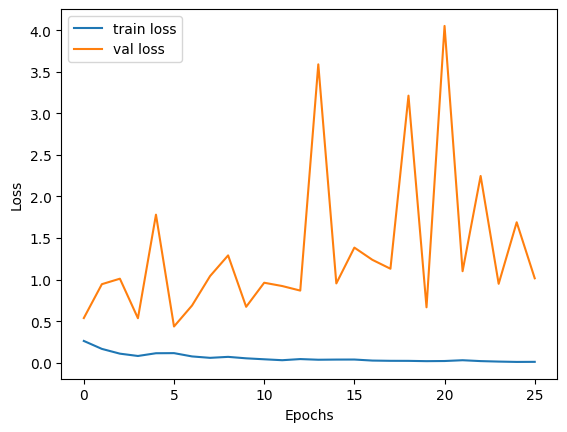

In [ ]:
plot_graph_loss(train_losses, validation_losses)